# 概要
## 資料集 CNC Mill Tool Wear
由密西根大學系統級製造和自動化研究測試台(SMART)的CNC銑床機，對2" x 2" x 1.5"的蠟塊，進行一系列的加工實驗的紀錄資料，加工成品為S狀的蠟製零件。\
<img src='image\test_artifact.jpg' width="200" height="200">
## 內容
**README.txt**\
記載實驗與資料集資訊，以及每項觀測值之單位。

**train.csv**\
提供18個不同實驗的輸入與輸出標籤：輸入包括實驗編號(No)、材料(material)、進給率(feedrate)和夾緊壓力(clamp_pressure)；輸出包含工具狀況(tool_condition)、加工完成(machining_finalized)與工具是否通過目視檢查(passed_visual_inspection)。

**experiment_\**.csv**\
為時間序列資料，取樣時間為100ms，進行18次實驗並記錄於資料experiment_01.csv至experiment_18.csv中，資料包含CNC中4組馬達(X、Y、Z軸與主軸S軸)的動作與電力相關觀測值。

加工操作階段(Machining_Process)依序為"Layer 1 Up", "Layer 1 Down", "Layer 2 Up", "Layer 2 Down", "Layer 3 Up", "Layer 3 Down"

## 觀察
進給率(feedrate)為刀具在材料中移動的速度，由進給計算公式:\
FR = RPM × T × CL\
FR為進給率；RPM為刀具轉速；T為刀具齒數；CL為每齒進給量\
雖然我們無法得知刀具材料與齒數資訊，但可以由公式得知進給率與主軸馬達轉速相關，而刀具磨損時會使切削效率下降，以及摩擦力增加，影響馬達狀態。
這提供我們一些想法：
1. 是否能夠由主軸馬達的狀態推斷刀具磨損情況。
2. 是否加工過程工具的移動會受刀具磨損情況影響。

## 目標
1. 探索製造加工資料處理程序
2. 實踐EDA技巧
3. 實踐資料可視化
4. 特徵工程與頻率域分析
5. 建模與訓練技巧


## 大綱
1. 讀取資料集
2. 資料前處理
3. EDA
4. 建模分類

In [1]:
import pandas as pd
import numpy as np
import os

In [2]:
path = 'data'
files = os.listdir(path)
print(files)

['experiment_01.csv', 'experiment_02.csv', 'experiment_03.csv', 'experiment_04.csv', 'experiment_05.csv', 'experiment_06.csv', 'experiment_07.csv', 'experiment_08.csv', 'experiment_09.csv', 'experiment_10.csv', 'experiment_11.csv', 'experiment_12.csv', 'experiment_13.csv', 'experiment_14.csv', 'experiment_15.csv', 'experiment_16.csv', 'experiment_17.csv', 'experiment_18.csv', 'README.txt', 'train.csv']


# 1. 讀取資料集
1.1. 讀取實驗標籤\
1.2. 讀取實驗歷時資料

## 1.1. 讀取實驗標籤
觀察到:
1. 實驗中8組工具磨損(worn)，10組未磨損(unworn)
2. 當machining_finalized為"no"時，passed_visual_inspectio為null值

In [3]:
label = pd.read_csv(os.path.join(path, 'train.csv'))
label.head(20)

,No,material,feedrate,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection
0,1,wax,6,4.0,unworn,yes,yes
1,2,wax,20,4.0,unworn,yes,yes
2,3,wax,6,3.0,unworn,yes,yes
3,4,wax,6,2.5,unworn,no,NaN
4,5,wax,20,3.0,unworn,no,NaN
5,6,wax,6,4.0,worn,yes,no
6,7,wax,20,4.0,worn,no,NaN
7,8,wax,20,4.0,worn,yes,no
8,9,wax,15,4.0,worn,yes,no
9,10,wax,12,4.0,worn,yes,no


In [4]:
label.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18 entries, 0 to 17
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   No                        18 non-null     int64  
 1   material                  18 non-null     object 
 2   feedrate                  18 non-null     int64  
 3   clamp_pressure            18 non-null     float64
 4   tool_condition            18 non-null     object 
 5   machining_finalized       18 non-null     object 
 6   passed_visual_inspection  14 non-null     object 
dtypes: float64(1), int64(2), object(4)
memory usage: 1.1+ KB


## 1.2. 讀取實驗歷時資料
以experiment_01.csv作為代表，具有48項特徵，包含四組馬達(X、Y、Z、S)的位置、速度、加速度、電流、電壓、功率等資訊

In [5]:
file_name = os.path.join(path, files[0])
df_tmp = pd.read_csv(file_name)
df_tmp.head()

,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,X1_OutputVoltage,...,S1_CurrentFeedback,S1_DCBusVoltage,S1_OutputCurrent,S1_OutputVoltage,S1_OutputPower,S1_SystemInertia,M1_CURRENT_PROGRAM_NUMBER,M1_sequence_number,M1_CURRENT_FEEDRATE,Machining_Process
0,198.0,0.0,0.00,198.0,0.0,0.000000,0.18,0.0207,329.0,2.77,...,0.524,2.740000e-19,329.0,0.0,6.960000e-07,12.0,1.0,0.0,50.0,Starting
1,198.0,-10.8,-350.00,198.0,-13.6,-358.000000,-10.90,0.1860,328.0,23.30,...,-0.288,2.740000e-19,328.0,0.0,-5.270000e-07,12.0,1.0,4.0,50.0,Prep
2,196.0,-17.8,-6.25,196.0,-17.9,-0.000095,-8.59,0.1400,328.0,30.60,...,0.524,2.740000e-19,328.0,0.0,9.100000e-07,12.0,1.0,7.0,50.0,Prep
3,194.0,-18.0,0.00,194.0,-17.9,-0.000095,-6.11,0.1300,327.0,30.30,...,-0.180,2.740000e-19,328.0,0.0,1.070000e-06,12.0,1.0,7.0,50.0,Prep
4,193.0,-17.9,-18.80,192.0,-17.9,0.000095,-5.70,0.1140,328.0,30.50,...,0.226,2.740000e-19,328.0,0.0,1.960000e-06,12.0,1.0,7.0,50.0,Prep


In [6]:
df_tmp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1055 entries, 0 to 1054
Data columns (total 48 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   X1_ActualPosition          1055 non-null   float64
 1   X1_ActualVelocity          1055 non-null   float64
 2   X1_ActualAcceleration      1055 non-null   float64
 3   X1_CommandPosition         1055 non-null   float64
 4   X1_CommandVelocity         1055 non-null   float64
 5   X1_CommandAcceleration     1055 non-null   float64
 6   X1_CurrentFeedback         1055 non-null   float64
 7   X1_DCBusVoltage            1055 non-null   float64
 8   X1_OutputCurrent           1055 non-null   float64
 9   X1_OutputVoltage           1055 non-null   float64
 10  X1_OutputPower             1055 non-null   float64
 11  Y1_ActualPosition          1055 non-null   float64
 12  Y1_ActualVelocity          1055 non-null   float64
 13  Y1_ActualAcceleration      1055 non-null   float

In [7]:
dict_dl = {}
print(files[0], 'Data length:', df_tmp.shape[0])
dict_dl[files[0]] = df_tmp.shape[0]

experiment_01.csv Data length: 1055


# 2. 資料預處理
2.1. 實驗標籤資料處理\
2.2. 實驗歷時資料處理 

## 2.1. 實驗標籤資料處理
將實驗標籤的二元類別轉成數值，並填補"passed_visual_inspection"的缺失值，進行Label Encoding

In [8]:
cols = ['material', 'tool_condition', 'machining_finalized', 'passed_visual_inspection']
for col in cols:
    print(col, 'unique:', label[col].unique())

material unique: ['wax']
tool_condition unique: ['unworn' 'worn']
machining_finalized unique: ['yes' 'no']
passed_visual_inspection unique: ['yes' nan 'no']


In [9]:
d_material = {'wax': 0}
d_tool_condition = {'unworn': 0, 'worn':1}
d_machining_finalized = {'yes': 1, 'no': 0}
d_passed_visual_inspection = {'yes':1, 'no': 0, np.nan: 0}
d_list = [d_material, d_tool_condition, d_machining_finalized, d_passed_visual_inspection]
for i in range(len(cols)):
    col = cols[i]
    d = d_list[i]
    label[col] = label[col].map(d)
label.head()

,No,material,feedrate,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection
0,1,0,6,4.0,0,1,1
1,2,0,20,4.0,0,1,1
2,3,0,6,3.0,0,1,1
3,4,0,6,2.5,0,0,0
4,5,0,20,3.0,0,0,0


## 2.2. 實驗歷時資料處理
將每項實驗資訊添加至實驗歷時資料中

In [10]:
df_tmp.insert(0, 'experiment', 1)
df_tmp['feedrate'] = label.iloc[0]['feedrate']
df_tmp['clamp_pressure'] = label.iloc[0]['clamp_pressure']
df_tmp['tool_condition'] = label.iloc[0]['tool_condition']
df_tmp['machining_finalized'] = label.iloc[0]['machining_finalized']
df_tmp['passed_visual_inspection'] = label.iloc[0]['passed_visual_inspection']

In [11]:
print(files[0],'shape:',df_tmp.shape)
df_tmp.head()

experiment_01.csv shape: (1055, 54)


,experiment,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,...,S1_SystemInertia,M1_CURRENT_PROGRAM_NUMBER,M1_sequence_number,M1_CURRENT_FEEDRATE,Machining_Process,feedrate,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection
0,1,198.0,0.0,0.00,198.0,0.0,0.000000,0.18,0.0207,329.0,...,12.0,1.0,0.0,50.0,Starting,6.0,4.0,0.0,1.0,1.0
1,1,198.0,-10.8,-350.00,198.0,-13.6,-358.000000,-10.90,0.1860,328.0,...,12.0,1.0,4.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
2,1,196.0,-17.8,-6.25,196.0,-17.9,-0.000095,-8.59,0.1400,328.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
3,1,194.0,-18.0,0.00,194.0,-17.9,-0.000095,-6.11,0.1300,327.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
4,1,193.0,-17.9,-18.80,192.0,-17.9,0.000095,-5.70,0.1140,328.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0


合併每項實驗的歷時資料，根據實驗取樣週期為100ms，加工時間最短的實驗為experiment_05 (46.2s)，最長的實驗為experiment_14.csv (233.2s)

In [12]:
df = df_tmp

In [13]:
for i in range(1,18):
    file_name = os.path.join(path, files[i])
    df_tmp = pd.read_csv(file_name)
    df_tmp.insert(0, 'experiment', i+1)
    df_tmp['feedrate'] = label.iloc[i]['feedrate']
    df_tmp['clamp_pressure'] = label.iloc[i]['clamp_pressure']
    df_tmp['tool_condition'] = label.iloc[i]['tool_condition']
    df_tmp['machining_finalized'] = label.iloc[i]['machining_finalized']
    df_tmp['passed_visual_inspection'] = label.iloc[i]['passed_visual_inspection']
    print(files[i],'shape:',df_tmp.shape)
    df = pd.concat([df, df_tmp])
    dict_dl[files[i]] = df_tmp.shape[0]

experiment_02.csv shape: (1668, 54)
experiment_03.csv shape: (1521, 54)
experiment_04.csv shape: (532, 54)
experiment_05.csv shape: (462, 54)
experiment_06.csv shape: (1296, 54)
experiment_07.csv shape: (565, 54)
experiment_08.csv shape: (605, 54)
experiment_09.csv shape: (740, 54)
experiment_10.csv shape: (1301, 54)
experiment_11.csv shape: (2314, 54)
experiment_12.csv shape: (2276, 54)
experiment_13.csv shape: (2233, 54)
experiment_14.csv shape: (2332, 54)
experiment_15.csv shape: (1381, 54)
experiment_16.csv shape: (602, 54)
experiment_17.csv shape: (2150, 54)
experiment_18.csv shape: (2253, 54)


In [14]:
print('min size:',min(list(dict_dl.values())), 'max size:', max(list(dict_dl.values())))

min size: 462 max size: 2332


In [15]:
df.head()

,experiment,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,...,S1_SystemInertia,M1_CURRENT_PROGRAM_NUMBER,M1_sequence_number,M1_CURRENT_FEEDRATE,Machining_Process,feedrate,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection
0,1,198.0,0.0,0.00,198.0,0.0,0.000000,0.18,0.0207,329.0,...,12.0,1.0,0.0,50.0,Starting,6.0,4.0,0.0,1.0,1.0
1,1,198.0,-10.8,-350.00,198.0,-13.6,-358.000000,-10.90,0.1860,328.0,...,12.0,1.0,4.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
2,1,196.0,-17.8,-6.25,196.0,-17.9,-0.000095,-8.59,0.1400,328.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
3,1,194.0,-18.0,0.00,194.0,-17.9,-0.000095,-6.11,0.1300,327.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0
4,1,193.0,-17.9,-18.80,192.0,-17.9,0.000095,-5.70,0.1140,328.0,...,12.0,1.0,7.0,50.0,Prep,6.0,4.0,0.0,1.0,1.0


In [16]:
df.shape

(25286, 54)

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25286 entries, 0 to 2252
Data columns (total 54 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   experiment                 25286 non-null  int64  
 1   X1_ActualPosition          25286 non-null  float64
 2   X1_ActualVelocity          25286 non-null  float64
 3   X1_ActualAcceleration      25286 non-null  float64
 4   X1_CommandPosition         25286 non-null  float64
 5   X1_CommandVelocity         25286 non-null  float64
 6   X1_CommandAcceleration     25286 non-null  float64
 7   X1_CurrentFeedback         25286 non-null  float64
 8   X1_DCBusVoltage            25286 non-null  float64
 9   X1_OutputCurrent           25286 non-null  float64
 10  X1_OutputVoltage           25286 non-null  float64
 11  X1_OutputPower             25286 non-null  float64
 12  Y1_ActualPosition          25286 non-null  float64
 13  Y1_ActualVelocity          25286 non-null  float64
 

處理多元類別Machining_Process

觀察到"Starting"與"end"類別比重非常小，且只存在於實驗1，推測為沒有統一的標籤，將標籤進行統一："Starting"等同"Prep"；"end"等同"End"
將多元類別轉換成數值，進行OneHotEncoding，並加入資料中

In [18]:
df['Machining_Process'].unique()

array(['Starting', 'Prep', 'Layer 1 Up', 'Layer 1 Down', 'Repositioning',
       'Layer 2 Up', 'Layer 2 Down', 'Layer 3 Up', 'Layer 3 Down', 'end',
       'End'], dtype=object)

In [19]:
df['Machining_Process'].value_counts()

Machining_Process
Layer 1 Up       4085
Repositioning    3377
Layer 2 Up       3104
Layer 3 Up       2794
Layer 1 Down     2655
End              2585
Layer 2 Down     2528
Layer 3 Down     2354
Prep             1795
end                 8
Starting            1
Name: count, dtype: int64

In [20]:
d_mp = {'Layer 1 Up':'MP_L1Up', 'Layer 1 Down':'MP_L1Down',
       'Layer 2 Up':'MP_L2Up', 'Layer 2 Down':'MP_L2Down', 'Layer 3 Up':'MP_L3Up', 'Layer 3 Down':'MP_L3Down',
       'Repositioning':'MP_Repositioning', 'End':'MP_End', 'end':'MP_End'}

df['MP_L1Up'] = 0
df['MP_L1Down'] = 0
df['MP_L2Up'] = 0
df['MP_L2Down'] = 0
df['MP_L3Up'] = 0
df['MP_L3Down'] = 0
df['MP_Repositioning'] = 0
df['MP_End'] = 0

for k in d_mp:
    df.loc[df['Machining_Process']==k, d_mp[k]] = 1

In [21]:
df.head()

,experiment,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,...,machining_finalized,passed_visual_inspection,MP_L1Up,MP_L1Down,MP_L2Up,MP_L2Down,MP_L3Up,MP_L3Down,MP_Repositioning,MP_End
0,1,198.0,0.0,0.00,198.0,0.0,0.000000,0.18,0.0207,329.0,...,1.0,1.0,0,0,0,0,0,0,0,0
1,1,198.0,-10.8,-350.00,198.0,-13.6,-358.000000,-10.90,0.1860,328.0,...,1.0,1.0,0,0,0,0,0,0,0,0
2,1,196.0,-17.8,-6.25,196.0,-17.9,-0.000095,-8.59,0.1400,328.0,...,1.0,1.0,0,0,0,0,0,0,0,0
3,1,194.0,-18.0,0.00,194.0,-17.9,-0.000095,-6.11,0.1300,327.0,...,1.0,1.0,0,0,0,0,0,0,0,0
4,1,193.0,-17.9,-18.80,192.0,-17.9,0.000095,-5.70,0.1140,328.0,...,1.0,1.0,0,0,0,0,0,0,0,0


缺失值檢查

In [22]:
df.isnull().sum().values

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25286 entries, 0 to 2252
Data columns (total 62 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   experiment                 25286 non-null  int64  
 1   X1_ActualPosition          25286 non-null  float64
 2   X1_ActualVelocity          25286 non-null  float64
 3   X1_ActualAcceleration      25286 non-null  float64
 4   X1_CommandPosition         25286 non-null  float64
 5   X1_CommandVelocity         25286 non-null  float64
 6   X1_CommandAcceleration     25286 non-null  float64
 7   X1_CurrentFeedback         25286 non-null  float64
 8   X1_DCBusVoltage            25286 non-null  float64
 9   X1_OutputCurrent           25286 non-null  float64
 10  X1_OutputVoltage           25286 non-null  float64
 11  X1_OutputPower             25286 non-null  float64
 12  Y1_ActualPosition          25286 non-null  float64
 13  Y1_ActualVelocity          25286 non-null  float64
 

# 3. EDA
3.1. 資料分布\
3.2. 特徵歷時變化\
3.3. 相關性分析\
3.4. 特徵工程與頻譜分析



In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

## 3.1. 資料分布
觀察實驗標籤於整體實驗資料的分布\
tool_condition: 未磨損與磨損比例大致持平\
machining_finalized: 未加工完成比例小於加工完成，推測未完成加工之實驗會提早結束，導致此情形\
passed_visual_inspection: 未通過目視確認比例小於通過目視確認

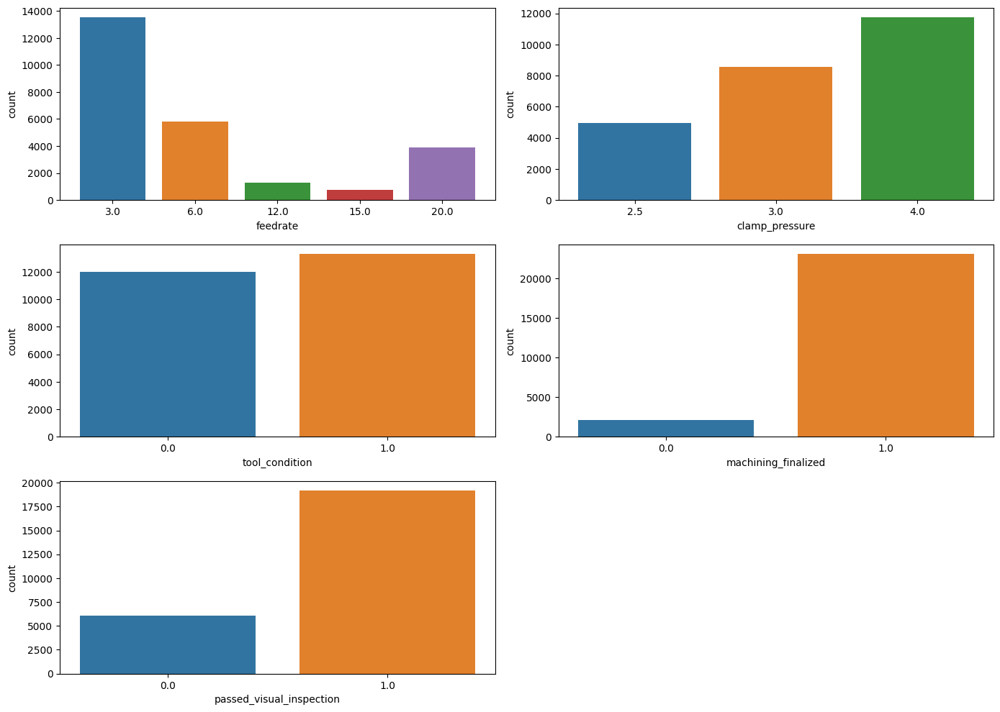

In [25]:
cols = ['feedrate', 'clamp_pressure', 'tool_condition', 'machining_finalized', 'passed_visual_inspection']
fig = plt.figure(figsize=(14, 10))
for i, col in enumerate(cols):
    plt.subplot(3,2, i+1)
    sns.countplot(x = df[col])
    plt.plot()
    plt.tight_layout()
plt.savefig('image\dist_label.png')
plt.show()


觀察實驗歷時資料的分布，以直方圖與箱型圖呈現\
大部分資料都非常態分布，具很大的偏度，推測各個馬達依加工階段可能具有特定運轉模式導致呈現這樣的分布

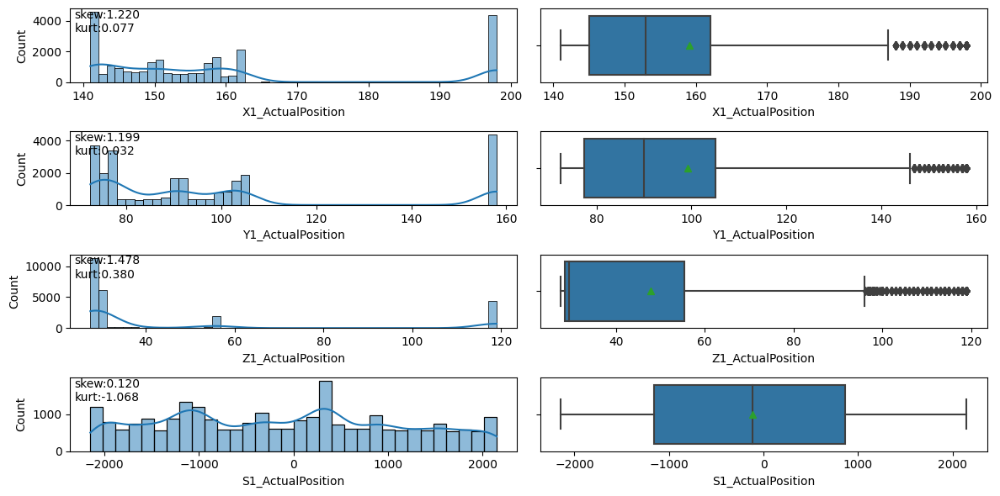

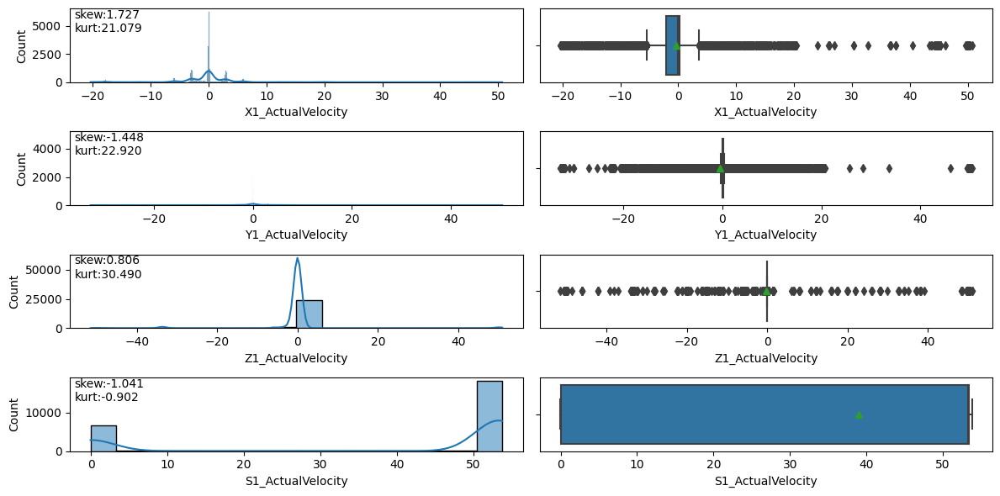

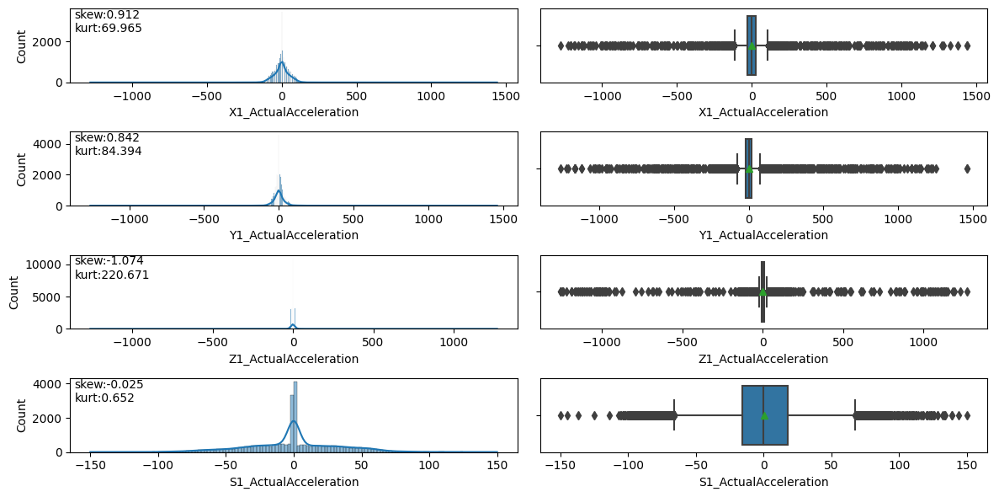

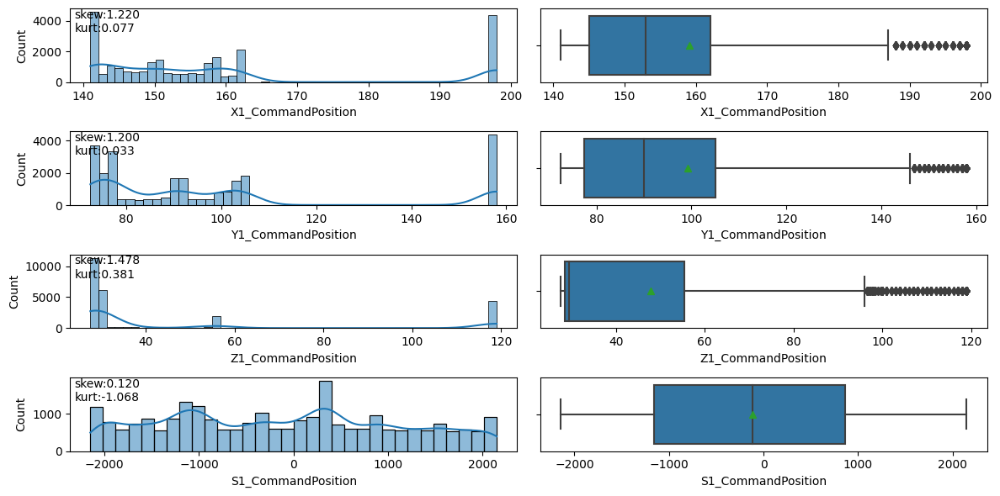

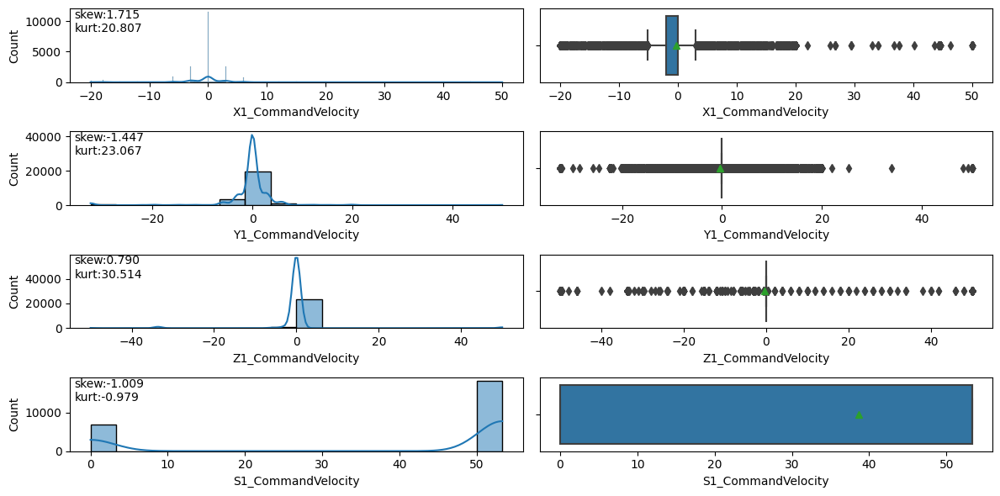

...

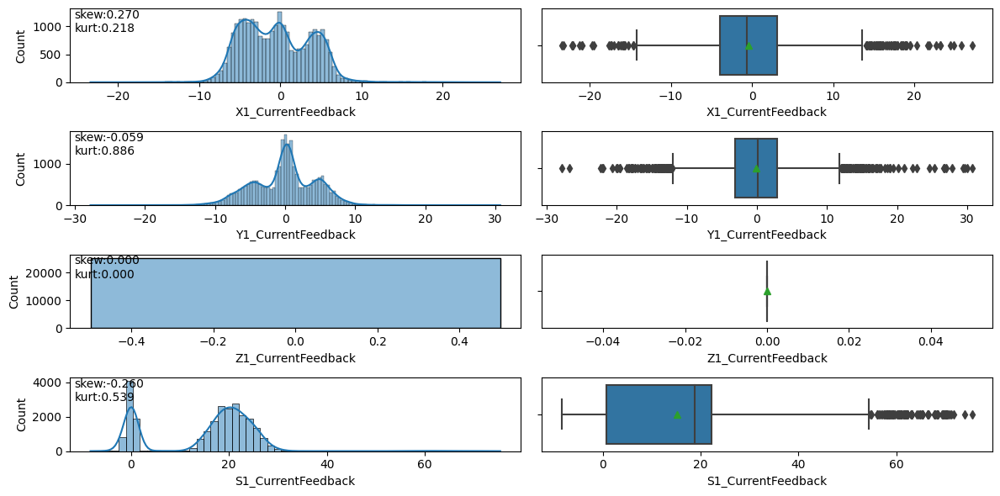

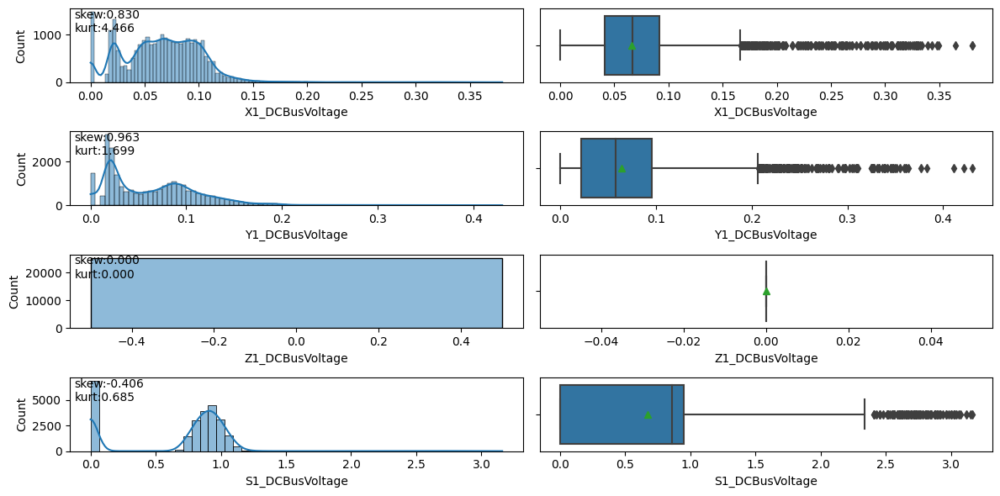

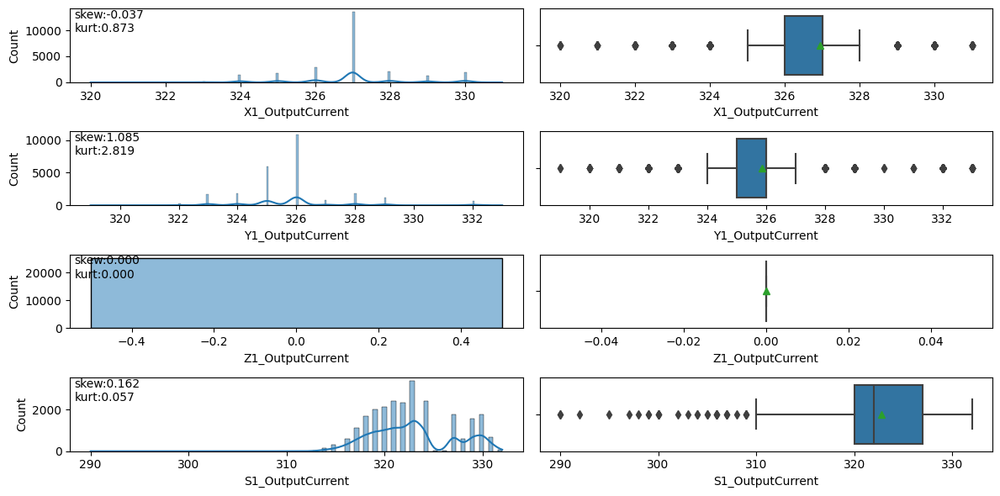

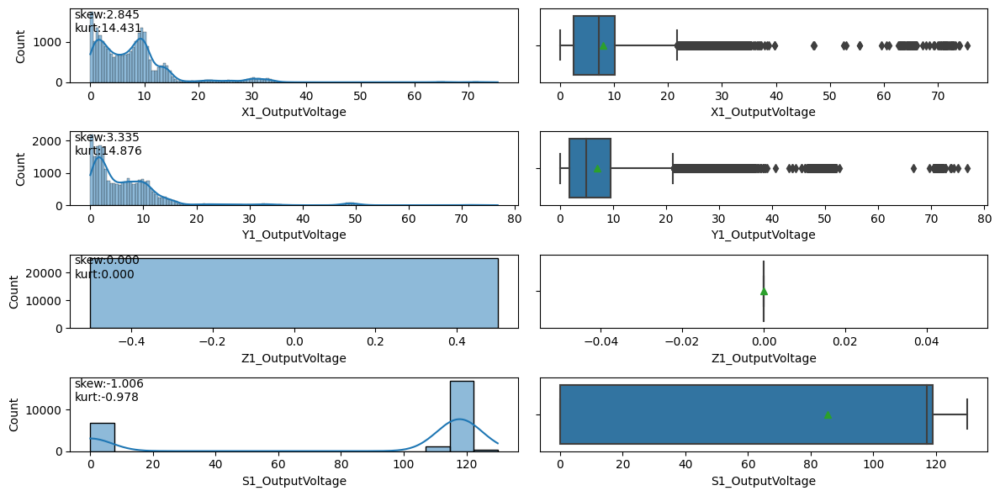

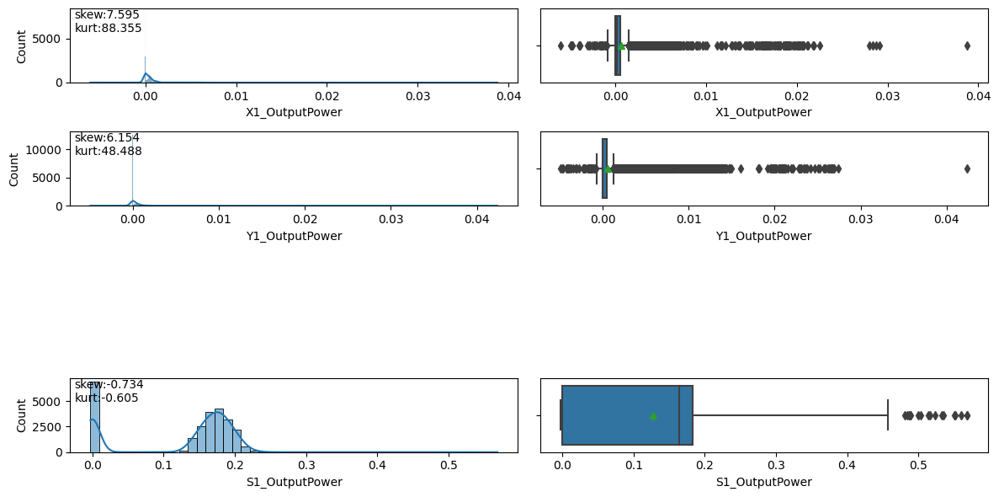

In [26]:
features = ['ActualPosition', 'ActualVelocity', 'ActualAcceleration', 'CommandPosition', 'CommandVelocity', 'CommandAcceleration', 
      'CurrentFeedback', 'DCBusVoltage', 'OutputCurrent', 'OutputVoltage', 'OutputPower']
axs = ['X', 'Y', 'Z', 'S']
for f in features:
    fig = plt.figure(figsize=(12, 6))
    for i, a in enumerate(axs):
        col = '{}1_{}'.format(a, f)
        if col in df:
            plt.subplot(4,2, i*2+1)
            ax = sns.histplot(x = df[col], kde=True)
            plt.text(.01, .99, 'skew:{:.3f}\nkurt:{:.3f}'.format(df[col].skew(), df[col].kurt()), ha='left', va='top', transform=ax.transAxes)
            plt.plot()
            plt.subplot(4,2, i*2+2)
            sns.boxplot(x = df[col], showmeans=True)
            plt.plot()
        
    plt.tight_layout()
    plt.savefig('image\dist_{}.png'.format(f))
    plt.show()

In [27]:
import math
def plot_exp1(df, col, n):
    n_row = math.ceil(n/6)
    for i in range(n):
        plt.subplot(n_row, 6, i+1)
        mp_list = ['MP_L1Up', 'MP_L1Down', 'MP_L2Up', 'MP_L2Down', 'MP_L3Up', 'MP_L3Down']
        c_list = ['C0', 'C1', 'C2', 'C3', 'C4', 'C5']
        for mp, c in zip(mp_list, c_list):
            df_tmp = df[(df['experiment']==i+1) & (df[mp]==1)]
            plt.plot([idx*0.1 for idx in df_tmp.index], df_tmp[col], color=c, label=mp)
        cond_others = ((df[mp_list[0]]==0) & (df[mp_list[1]]==0) & (df[mp_list[2]]==0) & (df[mp_list[3]]==0) & (df[mp_list[4]]==0) & (df[mp_list[5]]==0))
        df_tmp = df[(df['experiment']==i+1) & (cond_others)]
        start = 0
        label = 'others'
        for j in range(1, len(df_tmp)):
            if df_tmp.index[j] != df_tmp.index[j-1] + 1:
                plt.plot([idx*0.1 for idx in df_tmp.index[start:j]], df_tmp[col].iloc[start:j], color='lightgray', label=label)
                label = None
                start = j
            elif i == len(df_tmp)-1:
                plt.plot([idx*0.1 for idx in df_tmp.index[start:j]], df_tmp[col].iloc[start:j], color='lightgray', label=label)
        plt.legend()
        plt.title('{}_exp{}'.format(col, i+1))
        plt.xlabel('Time (sec)')
        d_units = {'Position':'mm', 'Velocity':'mm/s', 'Acceleration':'mm/s^2', 'Current':'A', 'Voltage':'V', 'Power':'kW'}
        yl = None
        for k in d_units:
            if k in col:
                yl = d_units[k]
        if yl:
            plt.ylabel(yl)
        plt.tight_layout()
    
def plot_exp2(df, col1, col2, n):
    n_row = math.ceil(n/6)
    for i in range(n):
        plt.subplot(n_row, 6, i+1)
        df1 = df[df['experiment']==i+1][col1]
        df2 = df[df['experiment']==i+1][col2]
        plt.plot(df1.index, df1, label=col1)
        plt.plot(df2.index, df2, label=col2)
        plt.plot(df1.index, abs(df1-df2), label='diff')
        plt.legend()
        plt.title('{}_exp{}'.format(col, i+1))
        plt.tight_layout()
    
        

## 3.2. 特徵歷時變化
觀察四軸馬達於加工期間位移、速度、電力功率的變化\
由於分析目標為工具磨損預測，工具實際接觸材料進行加工的數據觀測值較能反映工具狀態\
實際進行加工的六個階段標示為:["Layer 1 Up", "Layer 1 Down", "Layer 2 Up", "Layer 2 Down", "Layer 3 Up", "Layer 3 Down"]\
故擷取加工階段的資料，去除其他待機與移動階段的資料\
Z軸有在動作，但Z軸電壓與電流量測值皆為0，可能為感測器故障狀況\
依實驗標籤資訊，第4,5,7,16次實驗沒有完成加工，故實驗時間較短

feature: X1_ActualPosition (mm)


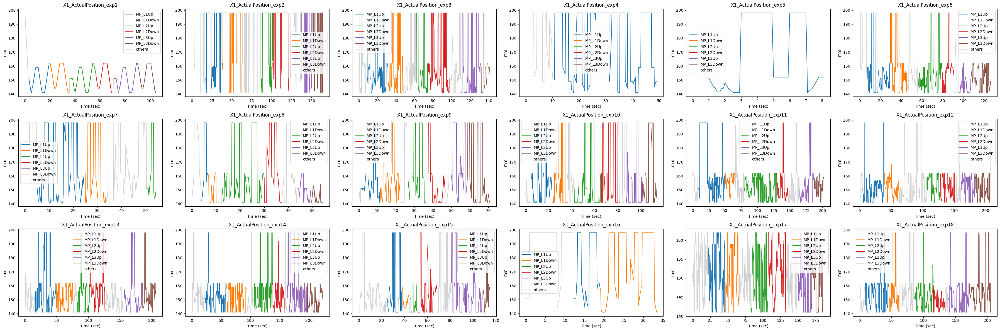

feature: Y1_ActualPosition (mm)


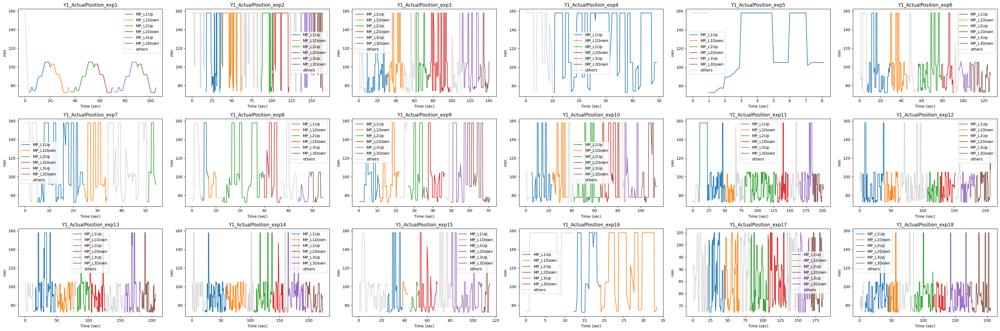

feature: Z1_ActualPosition (mm)


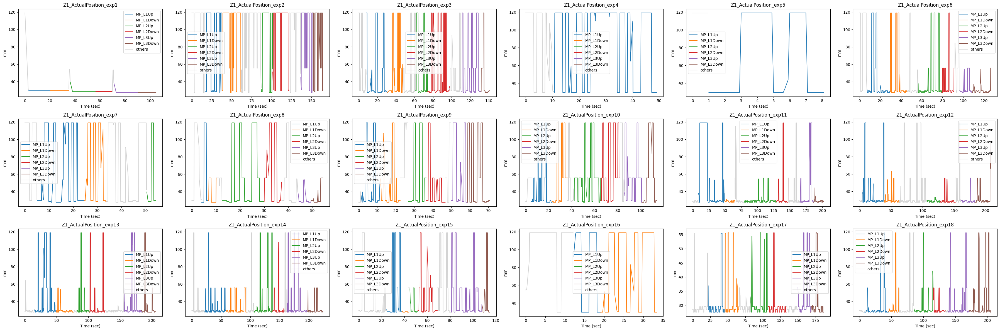

feature: S1_ActualPosition (mm)


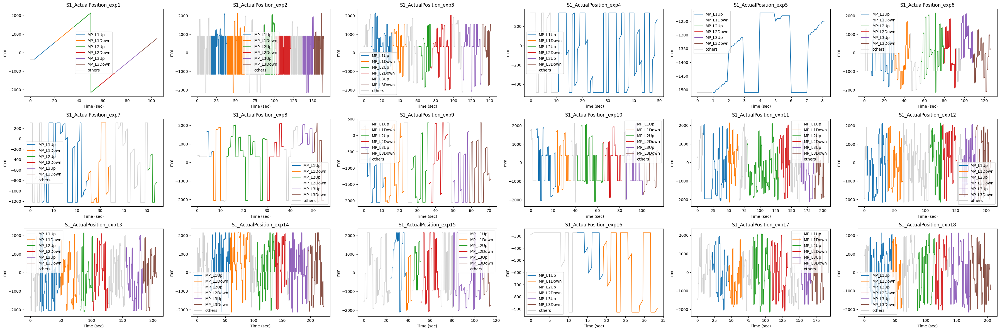

In [28]:
axs = ['X', 'Y', 'Z', 'S']
m = 'ActualPosition'
for ax in axs:
    col = '{}1_{}'.format(ax, m)
    if col in df:
        print('feature:', col, '(mm)')
        plt.figure(figsize=(36,12))
        plot_exp1(df, col, 18)
        plt.savefig(r'image\timeseries_{}.png'.format(col))
        plt.show()

feature: X1_ActualVelocity (mm/s)
feature: Y1_ActualVelocity (mm/s)
feature: Z1_ActualVelocity (mm/s)
feature: S1_ActualVelocity (mm/s)


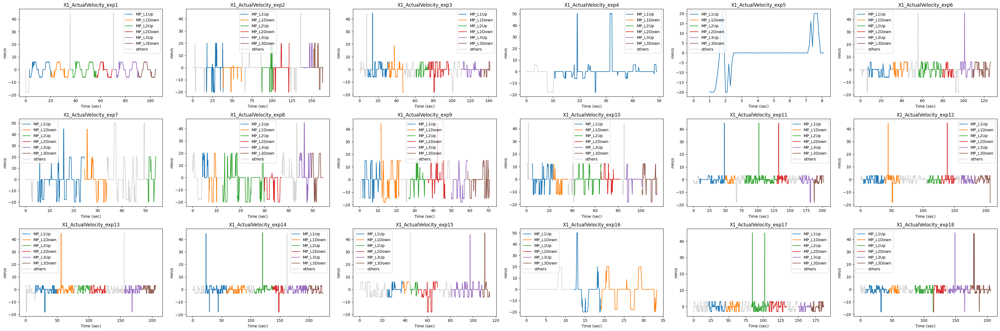

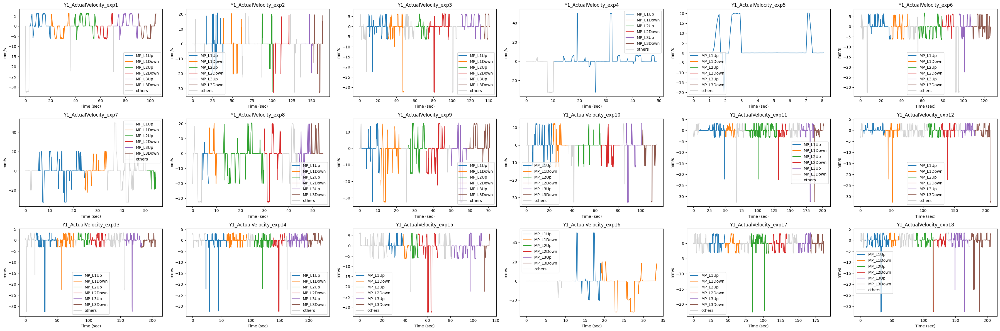

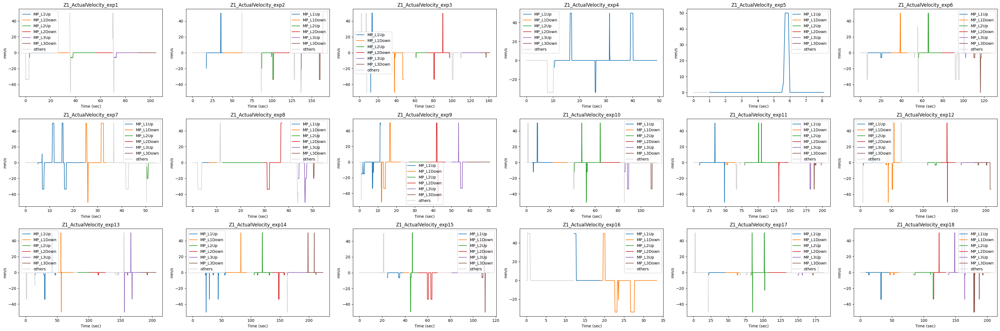

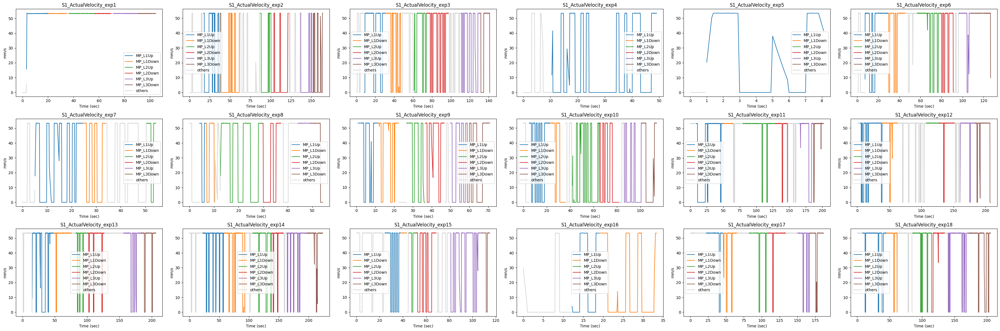

In [29]:
axs = ['X', 'Y', 'Z', 'S']
m = 'ActualVelocity'
for ax in axs:
    col = '{}1_{}'.format(ax, m)
    if col in df:
        print('feature:', col, '(mm/s)')
        plt.figure(figsize=(36,12))
        plot_exp1(df, col, 18)
        plt.savefig(r'image\timeseries_{}.png'.format(col))

feature: X1_ActualAcceleration (mm/s^2)
feature: Y1_ActualAcceleration (mm/s^2)
feature: Z1_ActualAcceleration (mm/s^2)
feature: S1_ActualAcceleration (mm/s^2)


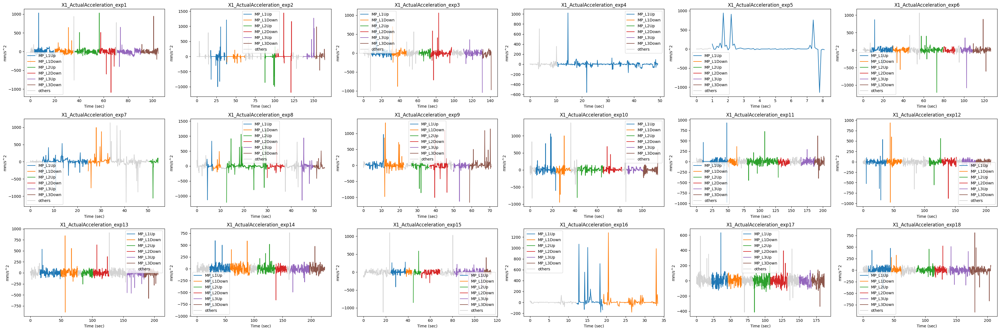

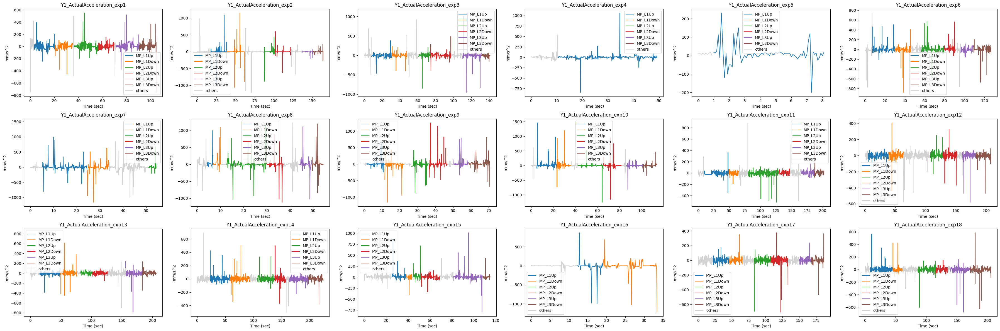

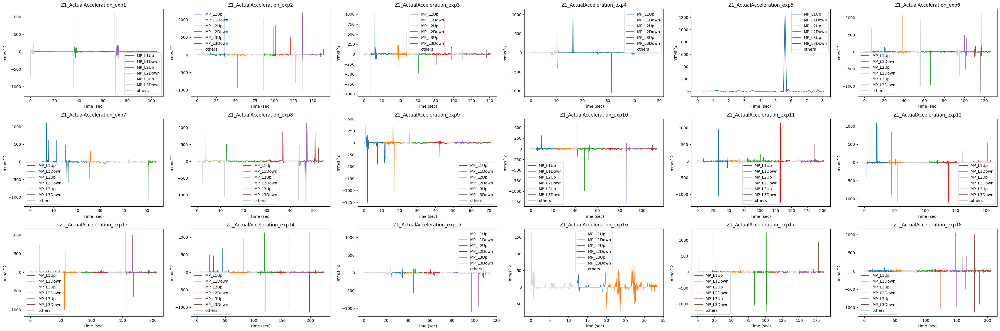

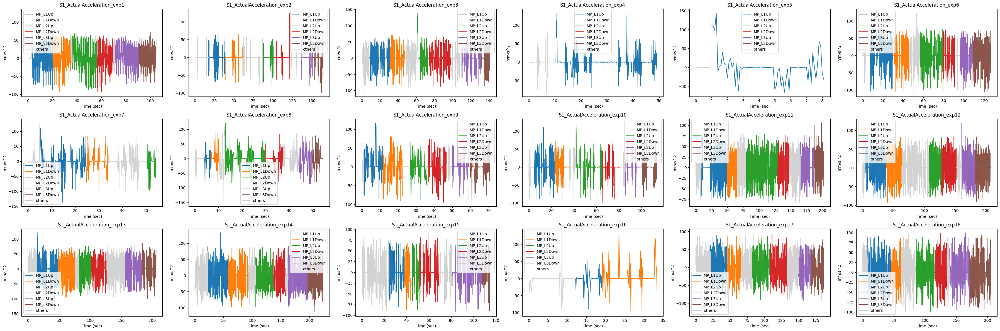

In [31]:
axs = ['X', 'Y', 'Z', 'S']
m = 'ActualAcceleration'
for ax in axs:
    col = '{}1_{}'.format(ax, m)
    if col in df:
        print('feature:', col, '(mm/s^2)')
        plt.figure(figsize=(36,12))
        plot_exp1(df, col, 18)
        plt.savefig(r'image\timeseries_{}.png'.format(col))

feature: X1_OutputPower (kW)
feature: Y1_OutputPower (kW)
feature: S1_OutputPower (kW)


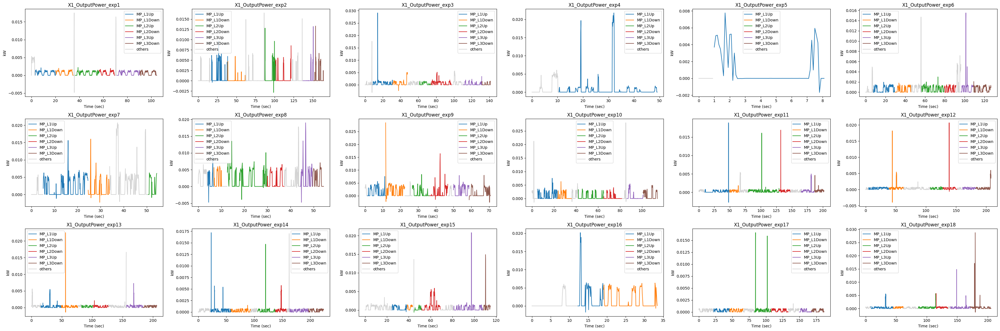

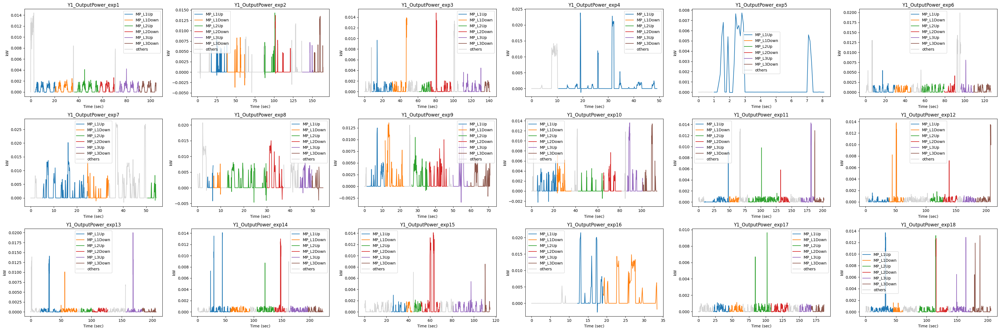

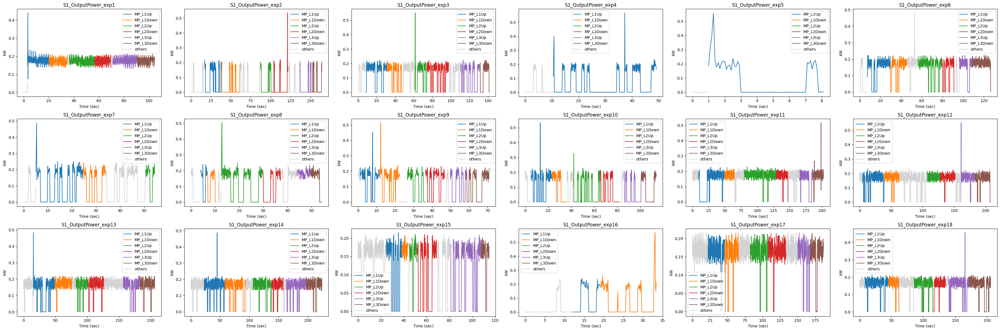

In [36]:
axs = ['X', 'Y', 'S']
m = 'OutputPower'
for ax in axs:
    col = '{}1_{}'.format(ax, m)
    if col in df:
        print('feature:', col, '(kW)')
        plt.figure(figsize=(36,12))
        plot_exp1(df, col, 18)
        plt.savefig(r'image\timeseries_{}.png'.format(col))

連接時間序列的X軸與Y軸的位置以重現加工過程工具移動軌跡

In [37]:
def plot_trajectory(df, col_x, col_y, color, label):
    start = 0
    for i in range(1, len(df)):
        if df.index[i] != df.index[i-1] + 1:
            plt.plot(df[col_x].iloc[start:i], df[col_y].iloc[start:i], color=color, label=label)
            label = None
            start = i
        elif i == len(df)-1:
            plt.plot(df[col_x].iloc[start:i], df[col_y].iloc[start:i], color=color, label=label)
            

左圖為完整的加工過程移動軌跡，右圖為擷取六個加工階段的移動軌跡\
若直接擷取六個加工階段的資料繪製，觀察到仍然有許多單純移動工具的操作

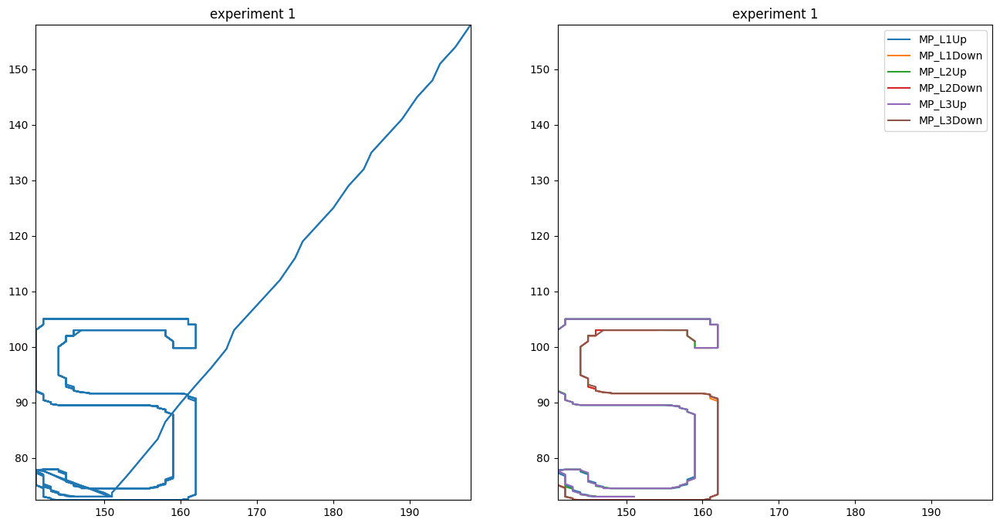

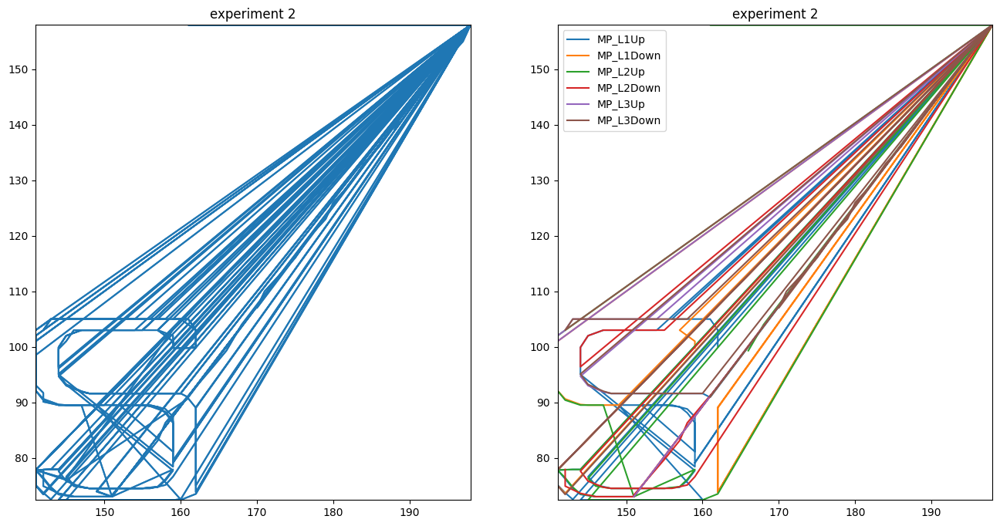

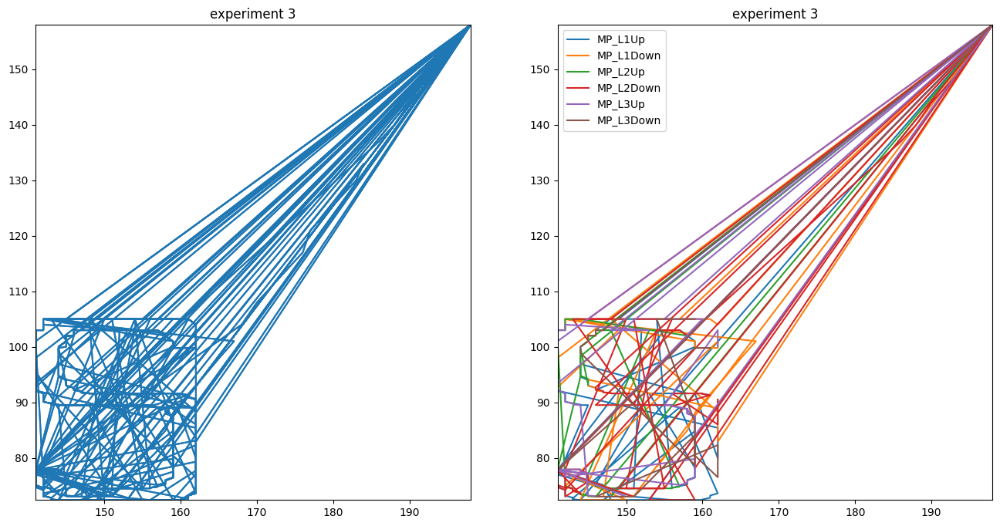

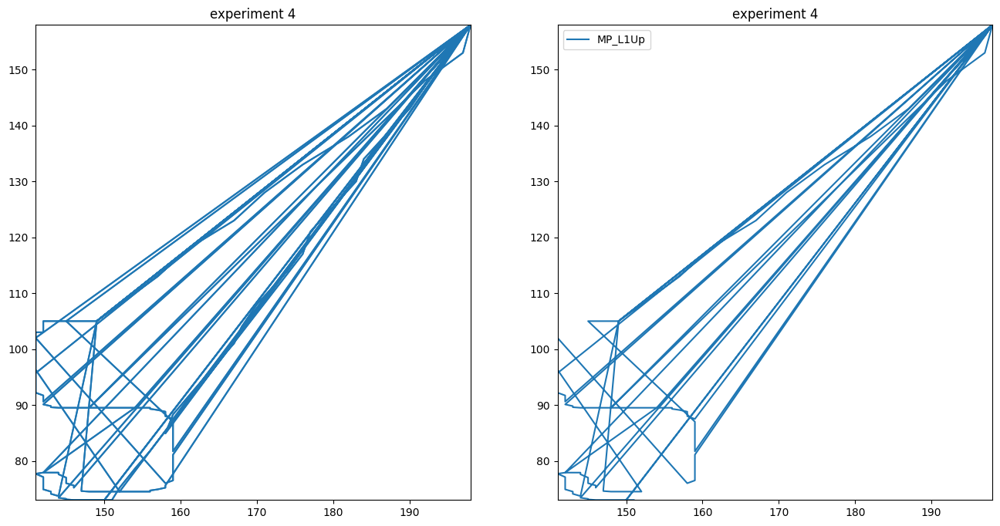

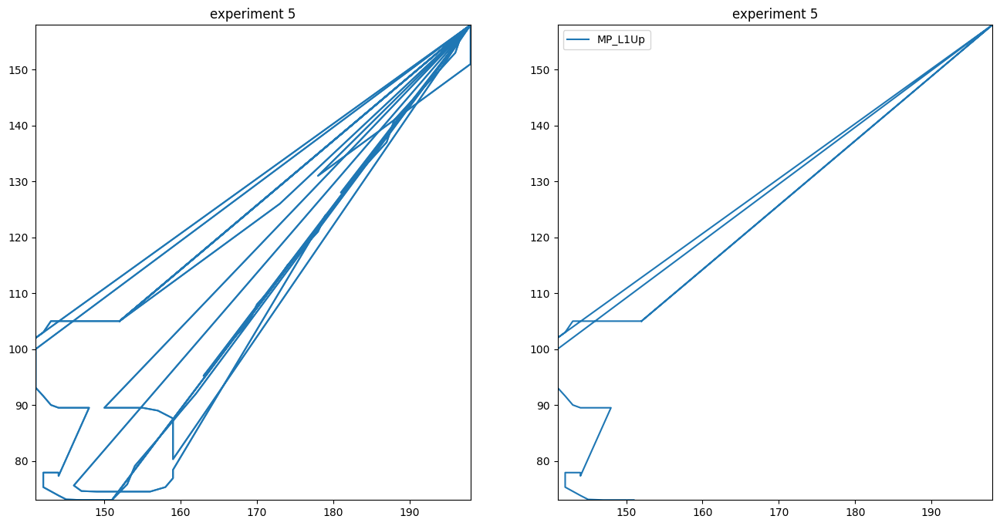

...

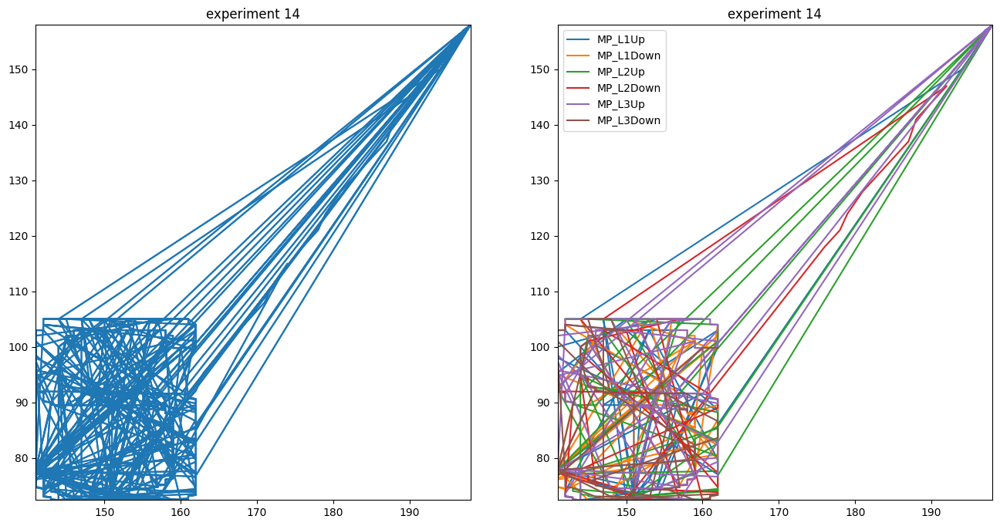

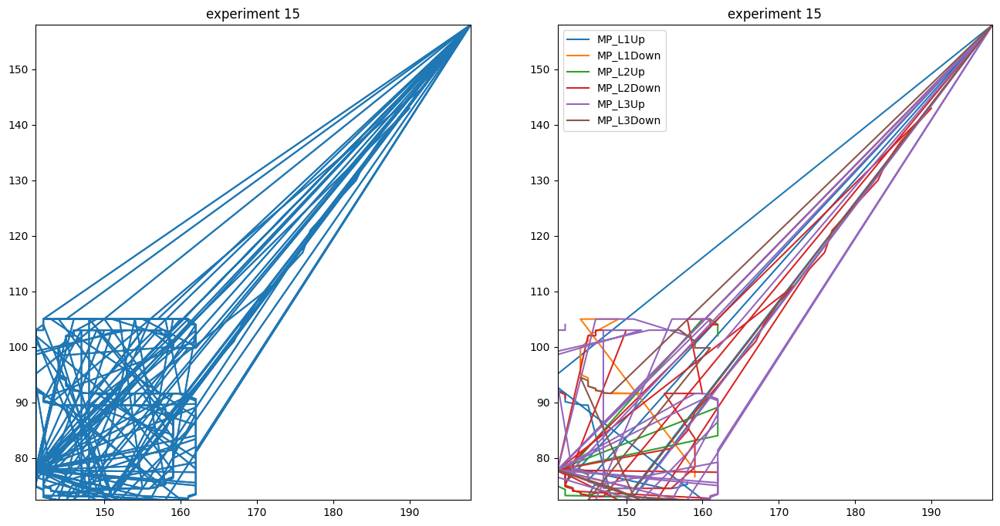

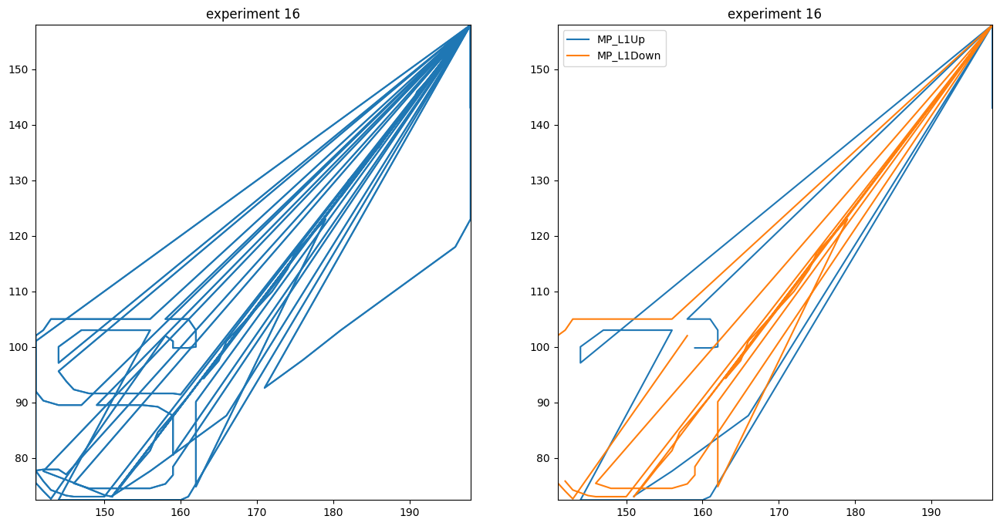

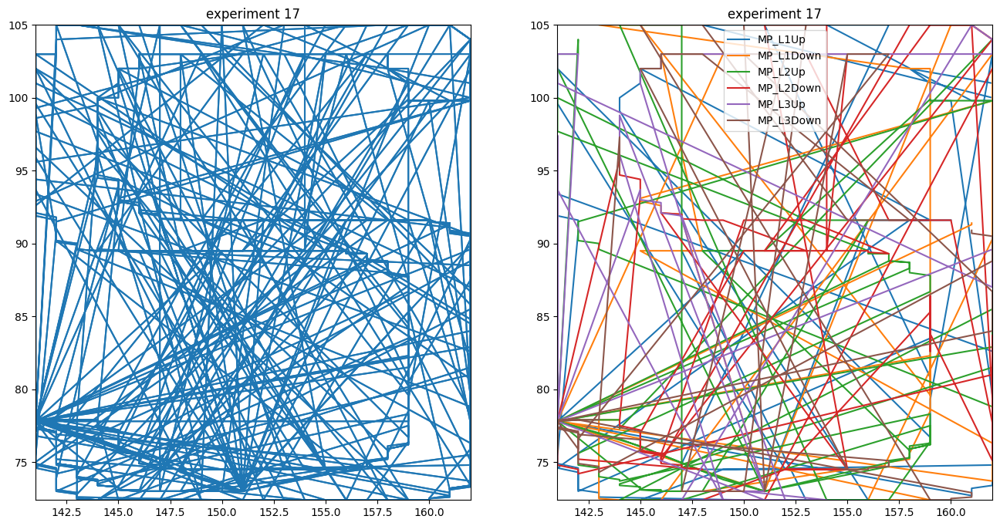

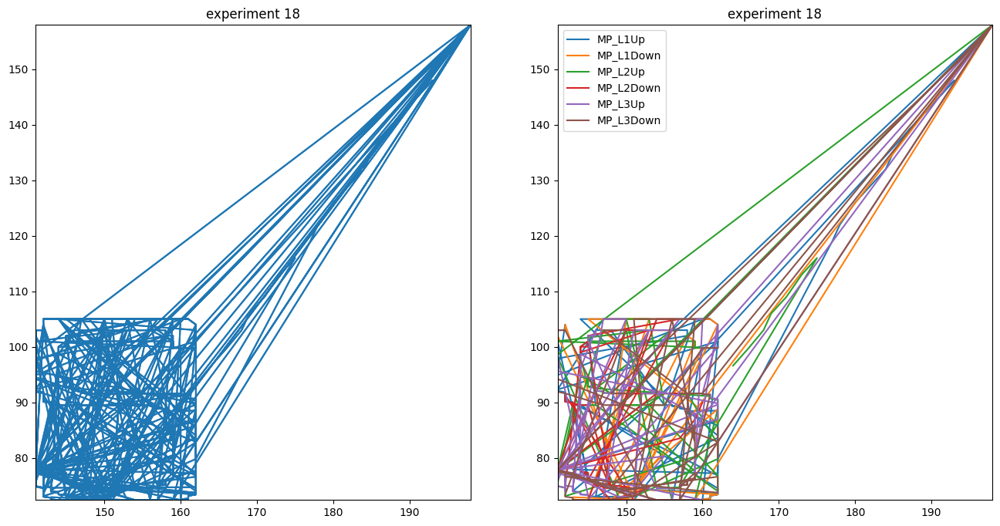

In [38]:
col_x = 'X1_ActualPosition'
col_y = 'Y1_ActualPosition'
mp_list = ['MP_L1Up', 'MP_L1Down', 'MP_L2Up', 'MP_L2Down', 'MP_L3Up', 'MP_L3Down']

for i in range(1,19):
    cond1 = (df['experiment']==i)
    
    plt.figure(figsize=(16,8))
    plt.subplot(1,2,1)
    plt.plot(df[cond1][col_x], df[cond1][col_y])
    plot_trajectory(df[cond1], col_x, col_y, color='C0', label=None)
    plt.title('experiment {}'.format(i))
    plt.xlim(min(df[df['experiment']==i][col_x]), max(df[df['experiment']==i][col_x]))
    plt.ylim(min(df[df['experiment']==i][col_y]), max(df[df['experiment']==i][col_y]))
    
    plt.subplot(1,2,2)
    for j, mp in enumerate(mp_list):
        plot_trajectory(df[cond1 & (df[mp]==1)], col_x, col_y, color='C{}'.format(j), label=mp)
    plt.legend()
    plt.title('experiment {}'.format(i))
    plt.xlim(min(df[df['experiment']==i]['X1_ActualPosition']), max(df[df['experiment']==i]['X1_ActualPosition']))
    plt.ylim(min(df[df['experiment']==i]['Y1_ActualPosition']), max(df[df['experiment']==i]['Y1_ActualPosition']))
    plt.savefig(r'image\trajectory_exp{}_0.png'.format(i))
    plt.show()

為進一步分離出加工過程的資料，建立特徵'S1_OutputPower'與'Z1_ActualPosition'之閾值，作為分離的條件\
考慮到蠟塊高度為1.5"，即38.1mm，'Z1_ActualPosition'最小值為27.5mm，評估以'Z1_ActualPosition'為80以下作為閾值\
而加工時工具的主軸馬達必須運轉，計算'S1_OutputPower'距平均值三個標準差以上作為閾值

重新繪製移動軌跡可見工具移動到原點段落被移除了\
第一次實驗軌跡清晰可見，但每次實驗的移動軌跡似乎都有所不同

In [39]:
mp_list = ['MP_L1Up', 'MP_L1Down', 'MP_L2Up', 'MP_L2Down', 'MP_L3Up', 'MP_L3Down']
df_tmp = df[(df['experiment']==1) & ((df[mp_list[0]]==1) | (df[mp_list[1]]==1) | (df[mp_list[2]]==1) | (df[mp_list[3]]==1) | (df[mp_list[4]]==1) | (df[mp_list[5]]==1))]
mean_power = df_tmp['S1_OutputPower'].mean()
std_power = df_tmp['S1_OutputPower'].std()
print('mean:',mean_power)
print('std:',std_power)
threshold_power = mean_power - 3*std_power
print('threshold:',threshold_power)

mean: 0.17728314833501513
std: 0.02195356229755713
threshold: 0.11142246144234373


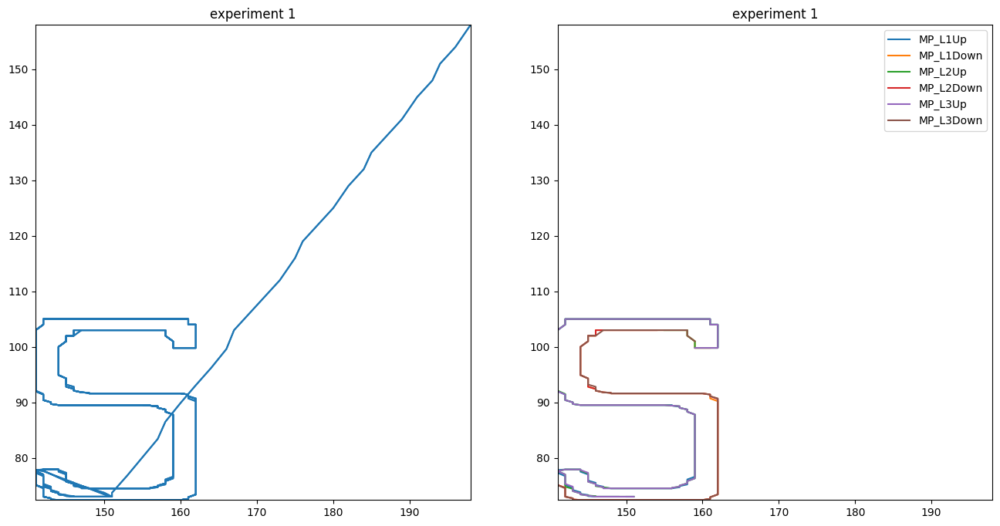

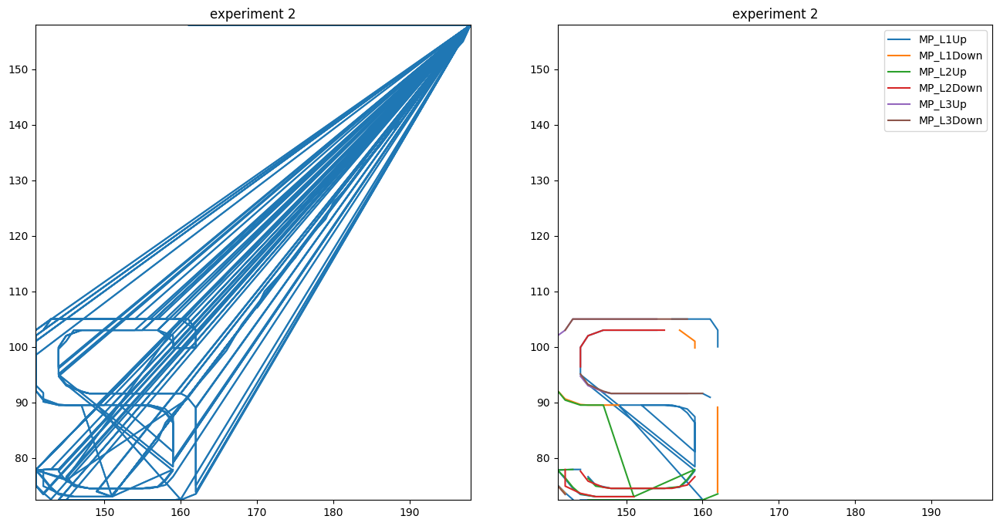

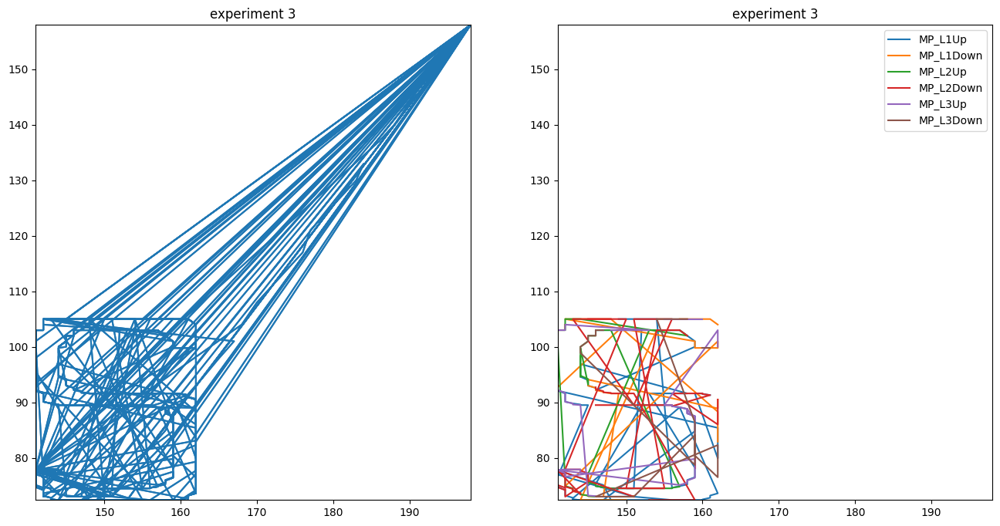

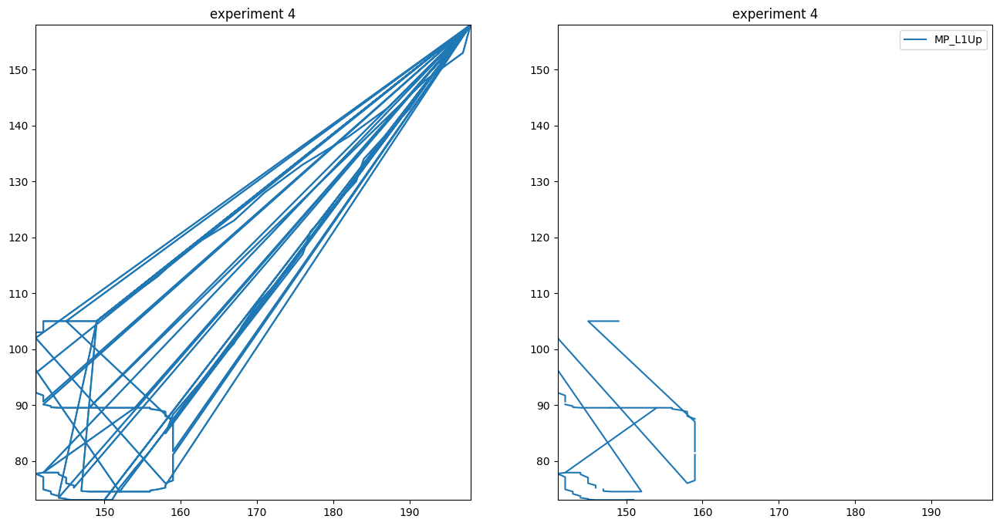

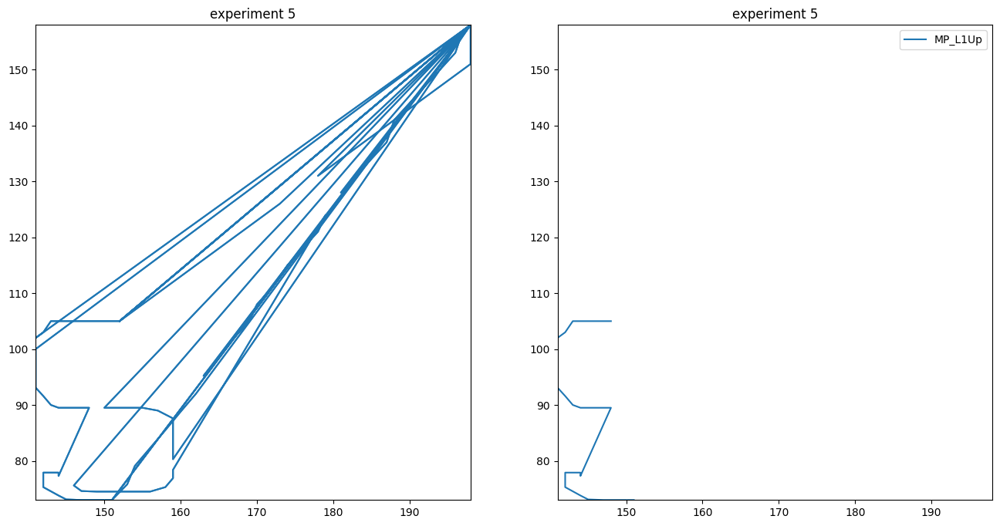

...

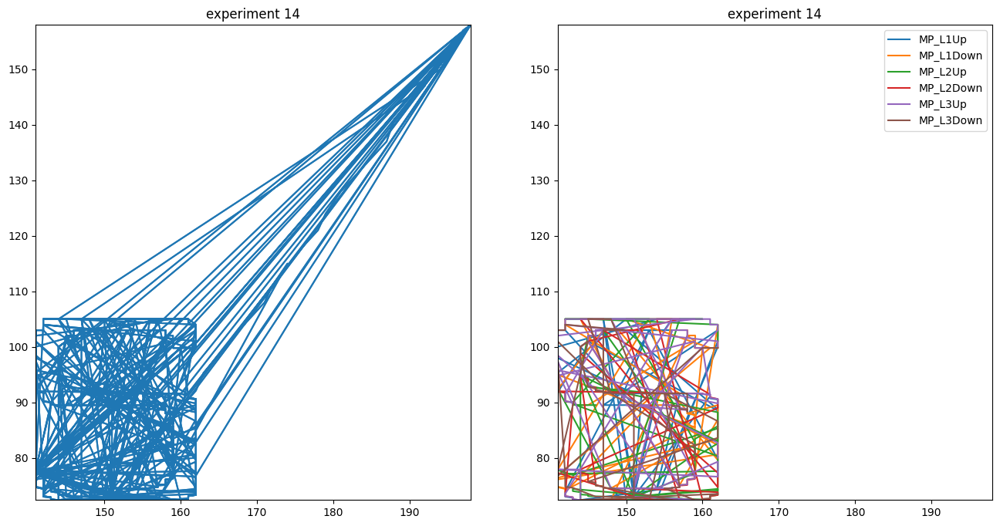

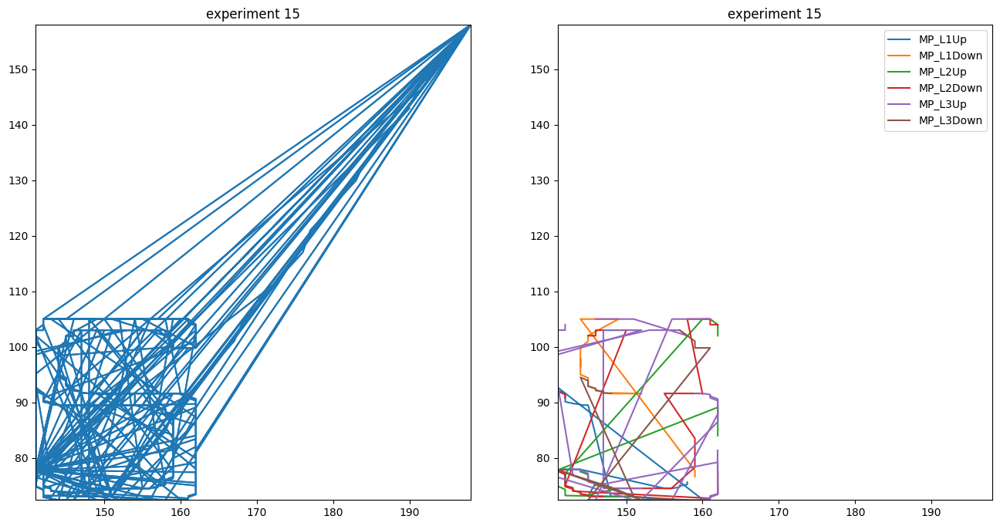

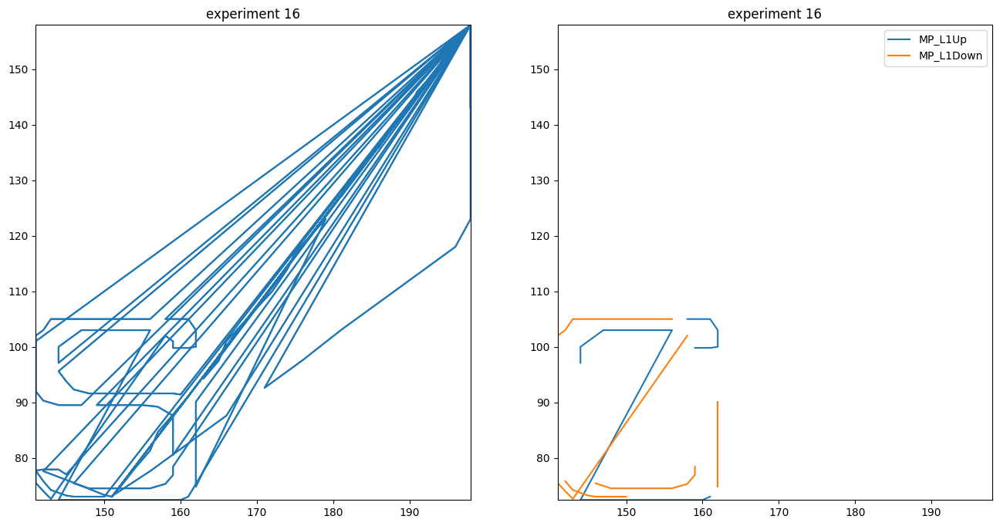

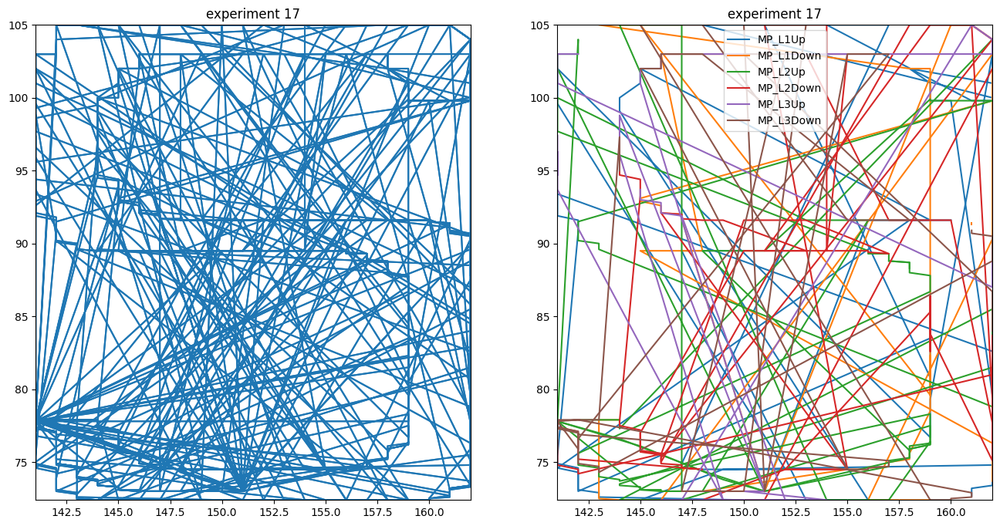

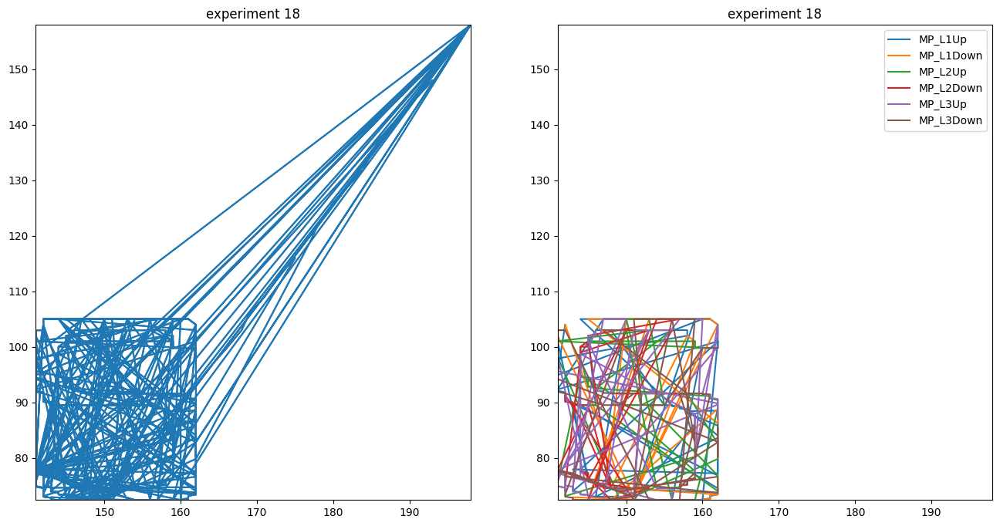

In [40]:
threshold_zp = 80
col_x = 'X1_ActualPosition'
col_y = 'Y1_ActualPosition'
for i in range(1,19):
    cond1 = (df['experiment']==i)
    cond2 = (df['S1_OutputPower']>threshold_power)
    cond3 = (df['Z1_ActualPosition']<threshold_zp)
    conds = (cond1 & cond2 & cond3)
    
    plt.figure(figsize=(16,8))
    plt.subplot(1,2,1)
    plt.plot(df[cond1][col_x], df[cond1][col_y])
    plot_trajectory(df[cond1], col_x, col_y, color='C0', label=None)
    plt.title('experiment {}'.format(i))
    plt.xlim(min(df[df['experiment']==i][col_x]), max(df[df['experiment']==i][col_x]))
    plt.ylim(min(df[df['experiment']==i][col_y]), max(df[df['experiment']==i][col_y]))
    
    plt.subplot(1,2,2)
    for j, mp in enumerate(mp_list):
        plot_trajectory(df[conds & (df[mp]==1)], col_x, col_y, color='C{}'.format(j), label=mp)

    plt.legend()
    plt.title('experiment {}'.format(i))
    plt.xlim(min(df[df['experiment']==i]['X1_ActualPosition']), max(df[df['experiment']==i]['X1_ActualPosition']))
    plt.ylim(min(df[df['experiment']==i]['Y1_ActualPosition']), max(df[df['experiment']==i]['Y1_ActualPosition']))
    plt.savefig(r'image\trajectory_exp{}_1.png'.format(i))
    plt.show()

依上述條件擷取資料

In [41]:
mp_list = ['MP_L1Up', 'MP_L1Down', 'MP_L2Up', 'MP_L2Down', 'MP_L3Up', 'MP_L3Down']
df_mp = df.loc[(df[mp_list[0]]==1) | (df[mp_list[1]]==1) | (df[mp_list[2]]==1) | (df[mp_list[3]]==1) | (df[mp_list[4]]==1) | (df[mp_list[5]]==1)]

conds = ((df_mp['S1_OutputPower']>threshold_power) & (df_mp['Z1_ActualPosition']<threshold_zp))
df_mp = df_mp[conds]
df_mp = df_mp.reset_index(drop=True)
df_mp = df_mp.drop(['Machining_Process', 'MP_Repositioning', 'MP_End'], axis=1)

In [42]:
print(df_mp.shape)
df_mp.head()

(13283, 59)


,experiment,X1_ActualPosition,X1_ActualVelocity,X1_ActualAcceleration,X1_CommandPosition,X1_CommandVelocity,X1_CommandAcceleration,X1_CurrentFeedback,X1_DCBusVoltage,X1_OutputCurrent,...,clamp_pressure,tool_condition,machining_finalized,passed_visual_inspection,MP_L1Up,MP_L1Down,MP_L2Up,MP_L2Down,MP_L3Up,MP_L3Down
0,1,151.0,0.075,37.50,151.0,0.0,0.0,0.878,0.0377,327.0,...,4.0,0.0,1.0,1.0,1,0,0,0,0,0
1,1,151.0,-0.075,-37.50,151.0,0.0,0.0,0.664,0.0332,325.0,...,4.0,0.0,1.0,1.0,1,0,0,0,0,0
2,1,151.0,-6.000,6.25,150.0,-6.0,0.0,-8.100,0.0983,323.0,...,4.0,0.0,1.0,1.0,1,0,0,0,0,0
3,1,150.0,-6.150,-43.80,150.0,-6.0,0.0,-6.420,0.1010,322.0,...,4.0,0.0,1.0,1.0,1,0,0,0,0,0
4,1,149.0,-5.930,-12.50,149.0,-6.0,0.0,-5.990,0.1130,325.0,...,4.0,0.0,1.0,1.0,1,0,0,0,0,0


## 3.3. 關聯性分析
進行標籤資料的線性相關性分析，取絕對值方便進行排序\
對於'tool_condition'，'passed_visual_inspection'存在弱相關性

In [43]:
label_corr = abs(label.drop(['No', 'material'], axis=1).corr()).sort_values(by='tool_condition', ascending=False).sort_values(by='tool_condition', ascending=False,axis=1)

In [44]:
label_corr

,tool_condition,passed_visual_inspection,clamp_pressure,feedrate,machining_finalized
tool_condition,1.000000,0.350000,0.245718,0.170259,0.059761
passed_visual_inspection,0.350000,1.000000,0.215003,0.651198,0.597614
clamp_pressure,0.245718,0.215003,1.000000,0.337490,0.256978
feedrate,0.170259,0.651198,0.337490,1.000000,0.511894
machining_finalized,0.059761,0.597614,0.256978,0.511894,1.000000


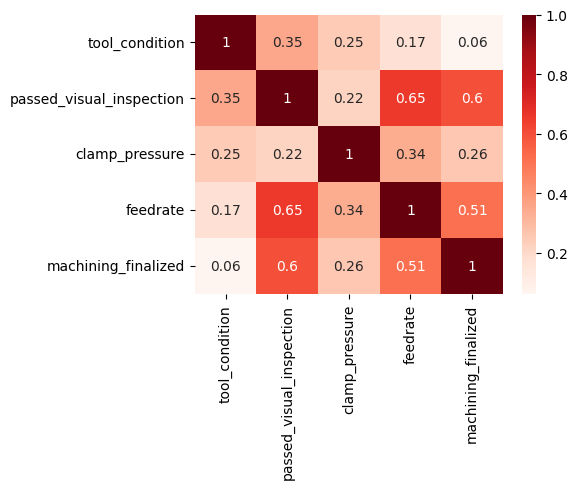

In [45]:
fig, ax = plt.subplots(figsize=(6,5)) 
sns.heatmap(label_corr, cmap="Reds", annot=True);
plt.savefig(r'image\label_corr.png', bbox_inches='tight')
plt.tight_layout()
plt.show()

進行實驗歷時資料的線性相關性分析，因特徵數量龐大，僅檢視特徵與'tool_condition'相關性，取絕對值方便進行排序\
對於'tool_condition'，相關係數超過0.1的特徵僅有'X1_OutputCurrent'與'Y1_OutputCurrent'，可能具微弱的線性相關

In [46]:
df_corr = abs(df_mp.drop(['experiment', 'passed_visual_inspection', 'clamp_pressure', 'feedrate', 'machining_finalized'], axis=1).corr()).sort_values(by='tool_condition', ascending=False)
df_corr['tool_condition'].head(20)

tool_condition           1.000000
X1_OutputCurrent         0.195642
Y1_OutputCurrent         0.151076
M1_CURRENT_FEEDRATE      0.096319
S1_OutputCurrent         0.073694
X1_OutputPower           0.067745
Y1_OutputPower           0.065741
X1_OutputVoltage         0.063006
Z1_CommandPosition       0.057005
Z1_ActualPosition        0.056690
Y1_OutputVoltage         0.053047
MP_L3Down                0.044396
MP_L2Up                  0.044228
MP_L2Down                0.042621
MP_L3Up                  0.036663
Y1_CurrentFeedback       0.034052
M1_sequence_number       0.030050
MP_L1Down                0.027715
Y1_ActualVelocity        0.019965
X1_ActualAcceleration    0.019902
Name: tool_condition, dtype: float64

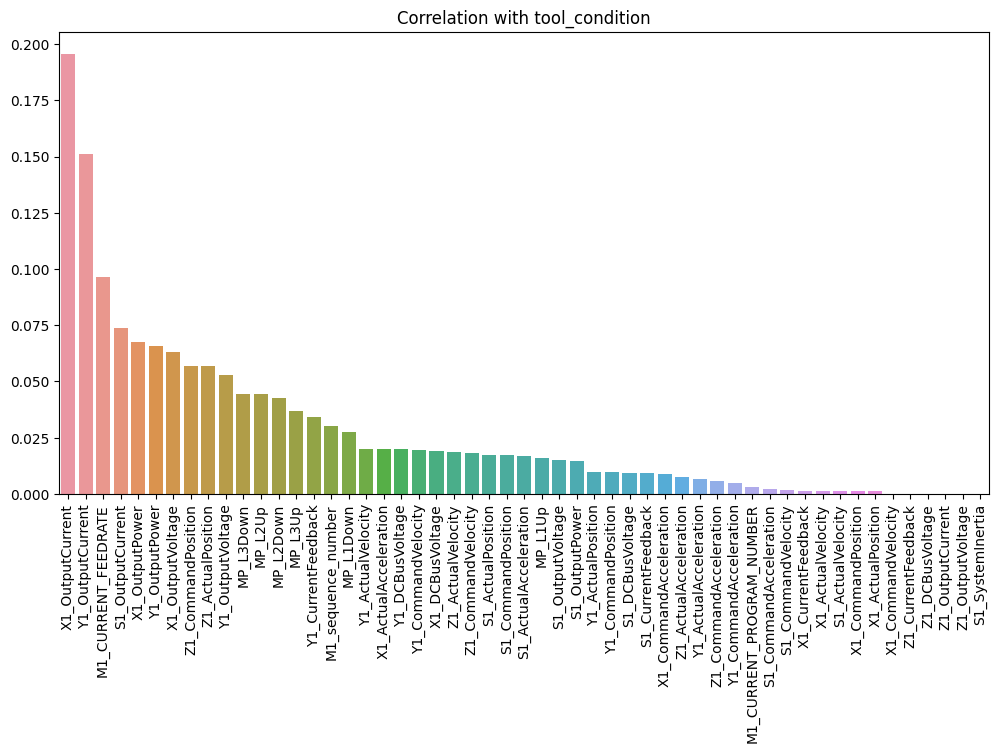

In [47]:
plt.figure(figsize=(12,6))
ax = sns.barplot(x=df_corr.index[1:], y=df_corr['tool_condition'].values[1:])
ax.tick_params(axis = "x", rotation = 90)
plt.title('Correlation with tool_condition')
plt.savefig(r'image\feature_corr.png', bbox_inches='tight')
plt.show()

## 3.4. 特徵工程與頻譜分析
考慮實驗資料的取樣週期為100ms (0.1s)，根據取樣定理，進行頻譜分析最大可識別頻率為取樣頻率的一半，即5Hz，經驗上過低的頻率難以反映加工時機械振動的特性\
但我們仍可嘗試對特徵進行頻譜分析，觀察是否可以得到有用資訊

分別對不同實驗進行頻譜分析，為確保時間連續性，以完整實驗資料進行分析\
考慮到加工過程有不同的加工階段，可能為非穩態訊號，使用STFT計算頻譜圖，並擷取每個時間步最大振幅與其頻率\
追跡誤差

In [48]:
from scipy.signal import stft
def plot_fft(df, col, n):
    res = []
    n_row = math.ceil(n/6)
    for i in range(n):
        plt.subplot(n_row, 6, i+1)
        df_tmp = df[(df['experiment']==i+1)][col]
        dt = 0.1
        t = np.arange(0, len(df_tmp)*dt, dt)
        freq = np.linspace(0, 1/dt, len(df_tmp))
        fft_y = np.fft.fft(df_tmp)
        fft_y_abs = np.abs(fft_y)/(len(df_tmp)/2)
        fft_y_abs[0] = fft_y_abs[0]/2
        max_index = np.argmax(fft_y_abs[:len(fft_y_abs)//2])
        max_amp = np.abs(fft_y_abs[max_index])
        max_frep = f[max_index]
        
        plt.plot(freq[:len(fft_y_abs)//2], fft_y_abs[:len(fft_y_abs)//2], color='C0')
        plt.scatter(freq[max_index], fft_y_abs[max_index], color='C1')
        plt.title('{}_exp{}'.format(col, i+1))
        plt.grid(True)
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Amplitude')
        plt.tight_layout()
        res.append((max_frep, max_amp))
    return res
        
def plot_stft(df, col, n):
    res = []
    w_size = 256
    n_row = math.ceil(n/6)
    for i in range(n):
        plt.subplot(n_row, 6, i+1)
        df_tmp = df[(df['experiment']==i+1)][col]
        dt = 0.1
        fs = 1/dt
        t = np.arange(0, (len(df_tmp)-1)*dt, dt)
        f, t, Zxx = stft(df_tmp, fs=fs, nperseg=w_size, noverlap=w_size*15//16)
        plt.pcolormesh(t, f, np.abs(Zxx))
        plt.colorbar(label='Amplitude')
        plt.title('{}_exp{}'.format(col, i+1))
        plt.ylabel('Frequency (Hz)]')
        plt.xlabel('Time (sec)')
        
        max_index = np.argmax(np.abs(Zxx), axis=0)
        max_amp = np.max(np.abs(Zxx), axis=0)
        max_frep = f[max_index]
        
        
        plt.tight_layout()
        
        res.append((max_frep, max_amp, t))
    return res
        
def map_time(t, v, dt, t_size):
    res = np.zeros(t_size)
    for i in range(1, len(v)):
        if int(t[i]/dt) < t_size:
            res[int(t[i-1]/dt):int(t[i]/dt)] = v[i-1]
        else:
            res[int(t[i-1]/dt):] = v[i-1]
            break
    return res

In [49]:
# axs = ['X', 'Y', 'Z', 'S']
# m = 'OutputPower'
# for ax in axs:
#     col = '{}1_{}'.format(ax, m)
#     if col in df:
#         plt.figure(figsize=(36,12))
#         plot_fft(df, col, 18)
#         plt.savefig(r'image\spectrum_{}.png'.format(col))
#         plt.show()

In [56]:
df_stft = df.copy()
d_stft = {}

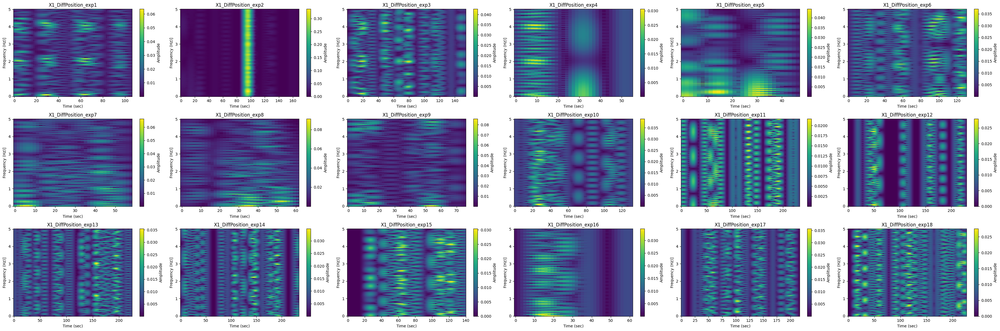

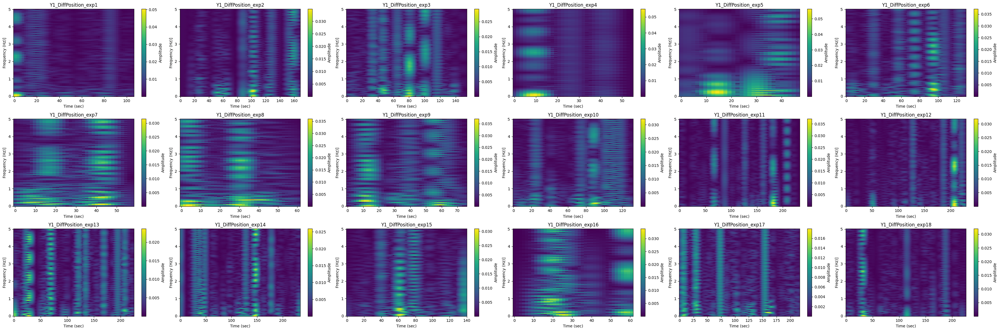

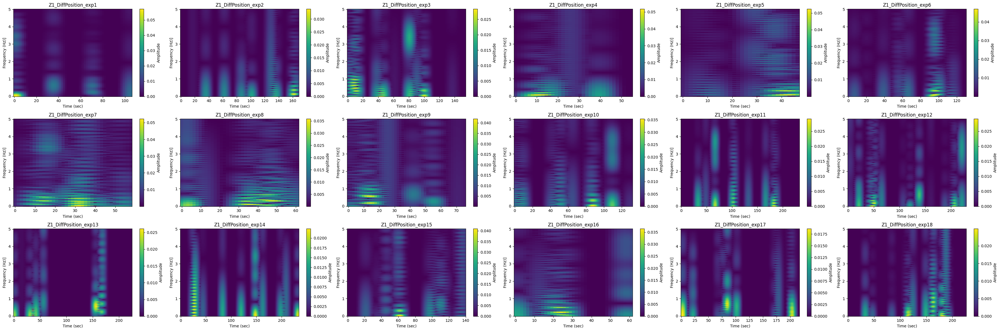

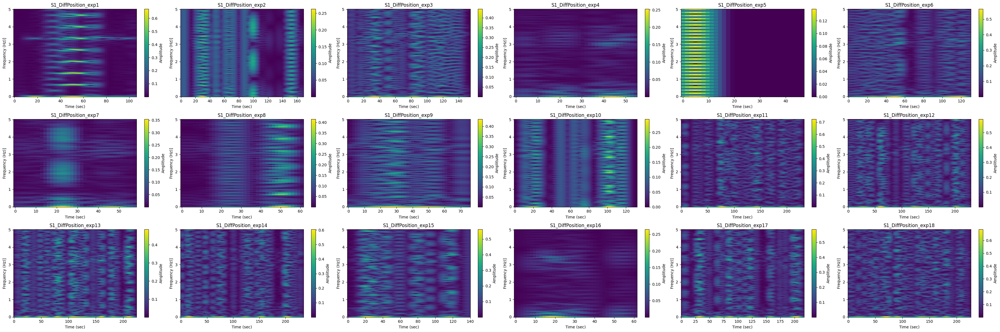

In [58]:
axs = ['X', 'Y', 'Z', 'S']
m = 'Position'
for ax in axs:
    m1 = 'Actual'+m
    m2 = 'Command'+m
    m3 = 'Diff'+m
    
    col1 = '{}1_{}'.format(ax, m1)
    col2 = '{}1_{}'.format(ax, m2)
    col3 = '{}1_{}'.format(ax, m3)
    df_tmp = df[['experiment', col1, col2]]
    df_tmp.insert(3, col3, df_tmp[col1] - df_tmp[col2])
    if col in df:
        d_stft[col3] = {}
        plt.figure(figsize=(36,12))
        res_stft = plot_stft(df_tmp, col3, 18)
        for i, res in enumerate(res_stft):
            f, a, t = res
            
            dt = 0.1
            t_size = len(df_tmp[df_tmp['experiment']==i+1])
            f_t = map_time(t, f, dt, t_size)
            a_t = map_time(t, a, dt, t_size)
            
            d_stft[col3][i+1]=(f_t, a_t)
        plt.savefig(r'image\spectrogram_{}.png'.format(col3))
        plt.show()
        

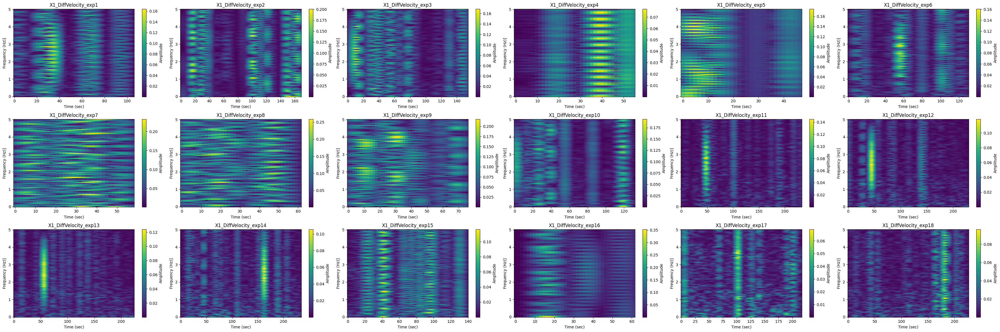

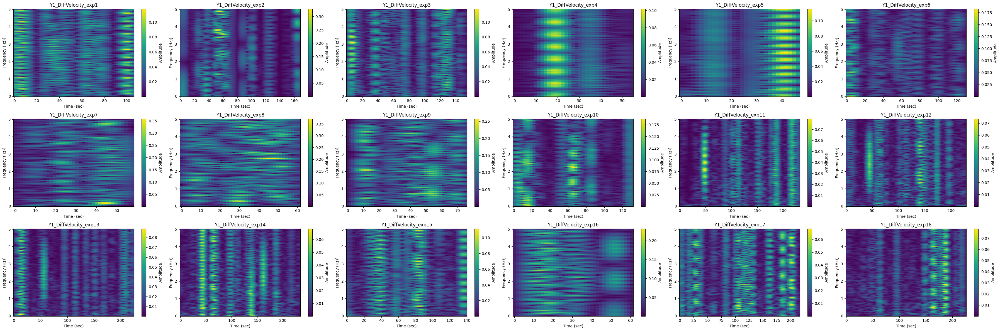

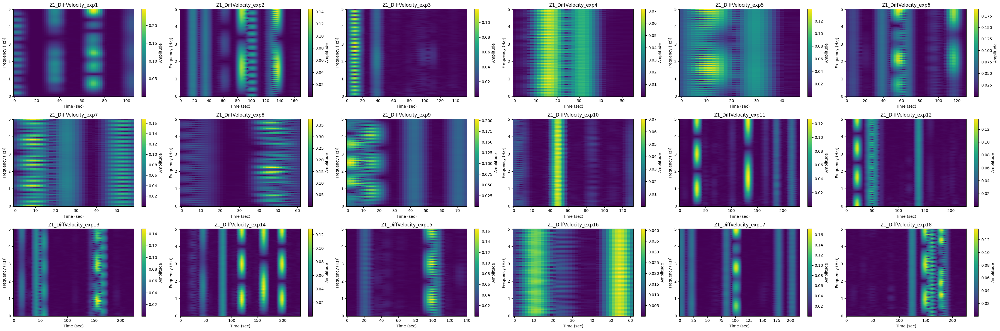

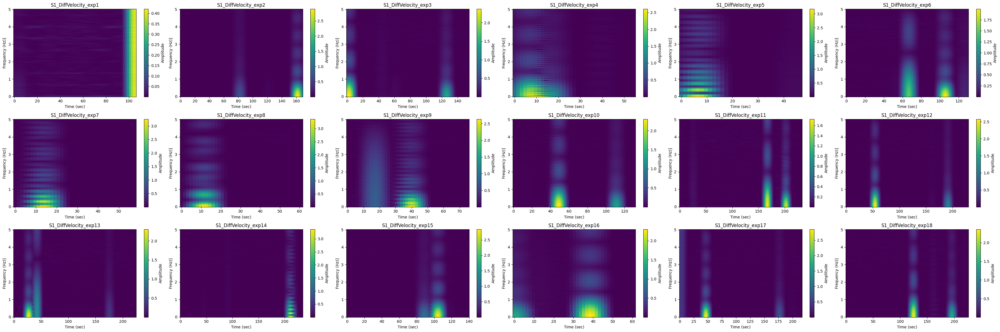

In [59]:
axs = ['X', 'Y', 'Z', 'S']
m = 'Velocity'
for ax in axs:
    m1 = 'Actual'+m
    m2 = 'Command'+m
    m3 = 'Diff'+m
    
    col1 = '{}1_{}'.format(ax, m1)
    col2 = '{}1_{}'.format(ax, m2)
    col3 = '{}1_{}'.format(ax, m3)
    df_tmp = df[['experiment', col1, col2]]
    df_tmp.insert(3, col3, df_tmp[col1] - df_tmp[col2])
    if col in df:
        d_stft[col3] = {}
        plt.figure(figsize=(36,12))
        res_stft = plot_stft(df_tmp, col3, 18)
        for i, res in enumerate(res_stft):
            f, a, t = res
            
            dt = 0.1
            t_size = len(df_tmp[df_tmp['experiment']==i+1])
            f_t = map_time(t, f, dt, t_size)
            a_t = map_time(t, a, dt, t_size)
            
            d_stft[col3][i+1]=(f_t, a_t)
        plt.savefig(r'image\spectrogram_{}.png'.format(col3))
        plt.show()

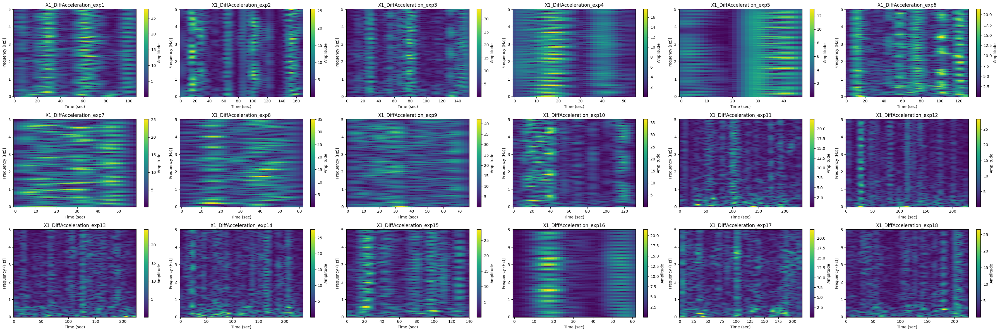

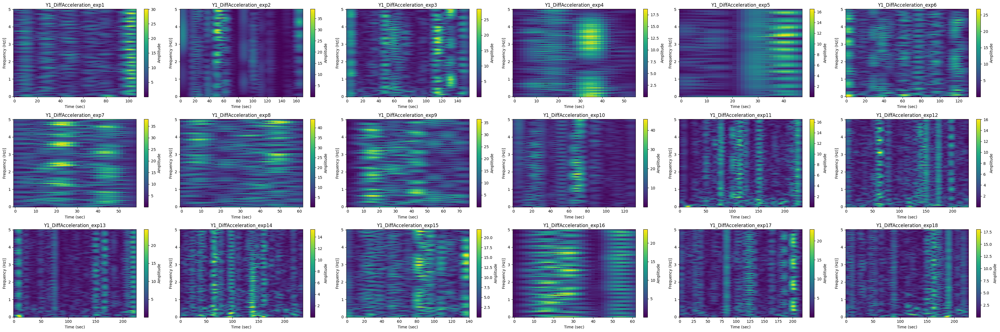

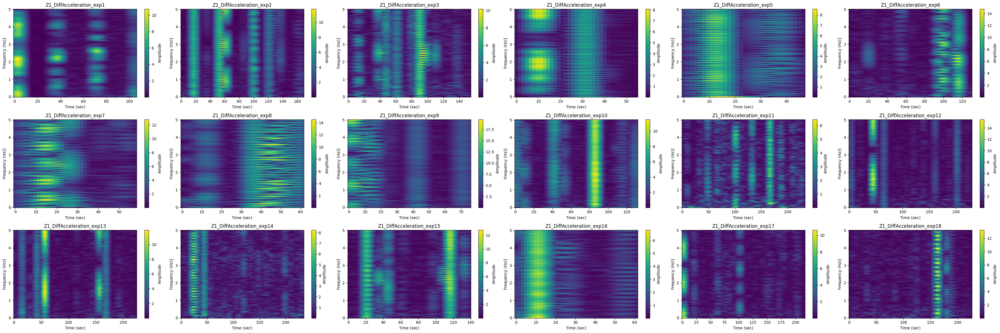

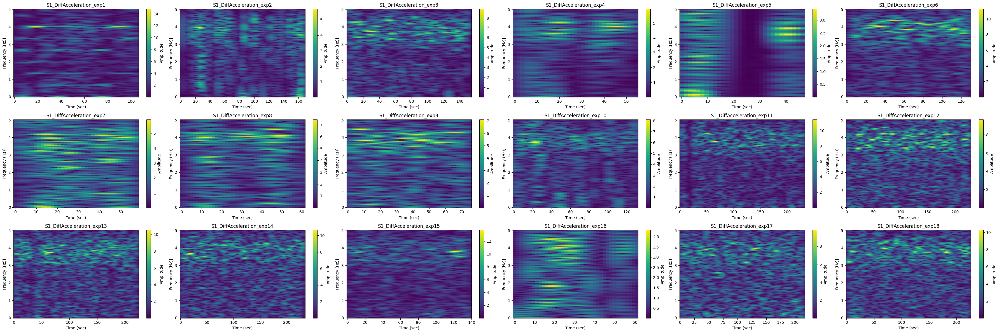

In [60]:
axs = ['X', 'Y', 'Z', 'S']
m = 'Acceleration'
for ax in axs:
    m1 = 'Actual'+m
    m2 = 'Command'+m
    m3 = 'Diff'+m
    
    col1 = '{}1_{}'.format(ax, m1)
    col2 = '{}1_{}'.format(ax, m2)
    col3 = '{}1_{}'.format(ax, m3)
    df_tmp = df[['experiment', col1, col2]]
    df_tmp.insert(3, col3, df_tmp[col1] - df_tmp[col2])
    if col in df:
        d_stft[col3] = {}
        plt.figure(figsize=(36,12))
        res_stft = plot_stft(df_tmp, col3, 18)
        for i, res in enumerate(res_stft):
            f, a, t = res
            
            dt = 0.1
            t_size = len(df_tmp[df_tmp['experiment']==i+1])
            f_t = map_time(t, f, dt, t_size)
            a_t = map_time(t, a, dt, t_size)
            
            d_stft[col3][i+1]=(f_t, a_t)
        plt.savefig(r'image\spectrogram_{}.png'.format(col3))
        plt.show()

In [61]:
print(d_stft.keys())

dict_keys(['X1_DiffPosition', 'Y1_DiffPosition', 'Z1_DiffPosition', 'S1_DiffPosition', 'X1_DiffVelocity', 'Y1_DiffVelocity', 'Z1_DiffVelocity', 'S1_DiffVelocity', 'X1_DiffAcceleration', 'Y1_DiffAcceleration', 'Z1_DiffAcceleration', 'S1_DiffAcceleration'])


In [62]:
for k in d_stft:
    col_f = k+'_freq'
    col_a = k+'_amp'
    df_stft[col_f] = 0
    df_stft[col_a] = 0
    for exp in d_stft[k]:
        df_stft.loc[df_stft['experiment'] == exp, col_f] = d_stft[k][exp][0]
        df_stft.loc[df_stft['experiment'] == exp, col_a] = d_stft[k][exp][1]

In [63]:
mp_list = ['MP_L1Up', 'MP_L1Down', 'MP_L2Up', 'MP_L2Down', 'MP_L3Up', 'MP_L3Down']
df_stft_mp = df_stft.loc[(df_stft[mp_list[0]]==1) | (df_stft[mp_list[1]]==1) | (df_stft[mp_list[2]]==1) | (df_stft[mp_list[3]]==1) | (df_stft[mp_list[4]]==1) | (df_stft[mp_list[5]]==1)]

conds = ((df_stft_mp['S1_OutputPower']>threshold_power) & (df_stft_mp['Z1_ActualPosition']<threshold_zp))
df_stft_mp = df_stft_mp[conds]

df_stft_mp = df_stft_mp.reset_index(drop=True)
df_stft_mp = df_stft_mp.drop(['Machining_Process', 'MP_Repositioning', 'MP_End'], axis=1)

In [64]:
df_stft_mp.shape

(13283, 83)

# 4. 建模
4.1. Decision Tree\
4.2. XGBoost

## 4.1. Decision Tree
訓練目標：分類工具是否磨損\
比較以下條件：
1. 原始資料與加工階段資料
2. KFold與GroupKFold
3. 加入頻譜分析為特徵

In [90]:
from sklearn import tree
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score

比較以原始資料或以經過清理的加工階段資料建立決策樹模型的差異

以KFold進行10次交叉驗證
data | mean accuracy
---|---
原始資料 | 92.81%
加工階段資料 | 97.38%

可見藉由挑選適當的資料區間作為判別該次實驗工具狀態的標準是有效的做法

原始資料

In [102]:
print(df.columns)

Index(['experiment', 'X1_ActualPosition', 'X1_ActualVelocity',
       'X1_ActualAcceleration', 'X1_CommandPosition', 'X1_CommandVelocity',
       'X1_CommandAcceleration', 'X1_CurrentFeedback', 'X1_DCBusVoltage',
       'X1_OutputCurrent', 'X1_OutputVoltage', 'X1_OutputPower',
       'Y1_ActualPosition', 'Y1_ActualVelocity', 'Y1_ActualAcceleration',
       'Y1_CommandPosition', 'Y1_CommandVelocity', 'Y1_CommandAcceleration',
       'Y1_CurrentFeedback', 'Y1_DCBusVoltage', 'Y1_OutputCurrent',
       'Y1_OutputVoltage', 'Y1_OutputPower', 'Z1_ActualPosition',
       'Z1_ActualVelocity', 'Z1_ActualAcceleration', 'Z1_CommandPosition',
       'Z1_CommandVelocity', 'Z1_CommandAcceleration', 'Z1_CurrentFeedback',
       'Z1_DCBusVoltage', 'Z1_OutputCurrent', 'Z1_OutputVoltage',
       'S1_ActualPosition', 'S1_ActualVelocity', 'S1_ActualAcceleration',
       'S1_CommandPosition', 'S1_CommandVelocity', 'S1_CommandAcceleration',
       'S1_CurrentFeedback', 'S1_DCBusVoltage', 'S1_OutputCurrent',


In [104]:
df_train = df.drop(['experiment', 'Machining_Process', 'passed_visual_inspection', 'clamp_pressure', 'feedrate', 'machining_finalized'], axis=1)
Y = df_train['tool_condition']
X = df_train.drop('tool_condition', axis=1)
# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=1234, stratify=Y)

clf = tree.DecisionTreeClassifier(max_depth=10, random_state=1234)
# clf.fit(X_train, Y_train)
scores = cross_val_score(clf, X, Y, cv=10)
print(scores)
print('mean scores:', scores.mean())

[0.95769079 0.9221036  0.96322657 0.88453934 0.78252274 0.95610913
 0.95530063 0.92167722 0.97389241 0.96439873]
mean scores: 0.9281461158160278


加工階段資料

In [106]:
print(df_mp.columns)

Index(['experiment', 'X1_ActualPosition', 'X1_ActualVelocity',
       'X1_ActualAcceleration', 'X1_CommandPosition', 'X1_CommandVelocity',
       'X1_CommandAcceleration', 'X1_CurrentFeedback', 'X1_DCBusVoltage',
       'X1_OutputCurrent', 'X1_OutputVoltage', 'X1_OutputPower',
       'Y1_ActualPosition', 'Y1_ActualVelocity', 'Y1_ActualAcceleration',
       'Y1_CommandPosition', 'Y1_CommandVelocity', 'Y1_CommandAcceleration',
       'Y1_CurrentFeedback', 'Y1_DCBusVoltage', 'Y1_OutputCurrent',
       'Y1_OutputVoltage', 'Y1_OutputPower', 'Z1_ActualPosition',
       'Z1_ActualVelocity', 'Z1_ActualAcceleration', 'Z1_CommandPosition',
       'Z1_CommandVelocity', 'Z1_CommandAcceleration', 'Z1_CurrentFeedback',
       'Z1_DCBusVoltage', 'Z1_OutputCurrent', 'Z1_OutputVoltage',
       'S1_ActualPosition', 'S1_ActualVelocity', 'S1_ActualAcceleration',
       'S1_CommandPosition', 'S1_CommandVelocity', 'S1_CommandAcceleration',
       'S1_CurrentFeedback', 'S1_DCBusVoltage', 'S1_OutputCurrent',


In [107]:
df_train = df_mp.drop(['experiment', 'passed_visual_inspection', 'clamp_pressure', 'feedrate', 'machining_finalized'], axis=1)
Y = df_train['tool_condition']
X = df_train.drop('tool_condition', axis=1)
# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=1234, stratify=Y)

clf = tree.DecisionTreeClassifier(max_depth=10, random_state=1234)
# clf.fit(X_train, Y_train)
scores = cross_val_score(clf, X, Y, cv=10)
print(scores)
print('mean scores:', scores.mean())

[0.98720843 0.9668924  0.97441685 0.98418675 0.96762048 0.96385542
 0.96460843 0.96310241 0.98418675 0.98192771]
mean scores: 0.9738005634275251


比較以KFold與GroupKFold方法進行交叉驗證的影響，以加工階段資料進行

因KFold將所有實驗一起抽選訓練及驗證資料，相當於同一組實驗的資料可能分散在訓練與驗證資料之中\
訓練時有資料洩漏的疑慮\
GroupKFold將每次實驗視為同一群組，抽選以群組為單位進行，以避免上述情況

method | mean accuracy
---|---
KFold | 97.38%
GroupKFold | 97.01%

可見資料洩漏對於此案例影響可能不明顯

觀察此決策樹的特徵重要度\
'Z1_ActualPosition'與'Z1_CommandPosition'占的比重遠大於其他特徵

GroupKFold

In [108]:
from sklearn.model_selection import GroupKFold

groups = df_mp['experiment']
group_kfold = GroupKFold(n_splits=18)
accuracy_scores = []
cols = list(X.columns)
for train_index, test_index in group_kfold.split(X, Y, groups):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    Y_train, Y_test = Y.iloc[train_index], Y.iloc[test_index]
    clf = tree.DecisionTreeClassifier(max_depth=10, random_state=1234)
    clf.fit(X_train, Y_train)
    pred = clf.predict(X_test)
    exp = df_mp.iloc[test_index]['experiment'].unique()
    acc = accuracy_score(Y_test, pred)
    print('no.', exp, ', test accuracy:', acc)
    df_fi = pd.Series(data = clf.feature_importances_, index = cols)
    df_fi = df_fi.sort_values(ascending=False)
    print('feature importances top 3:\n',df_fi.head(3))
    accuracy_scores.append(acc)
print(accuracy_scores)
print('mean scores:', np.mean(accuracy_scores))

no. [14] , test accuracy: 0.9740670461733081
feature importances top 3:
 Z1_ActualPosition     0.761855
Z1_CommandPosition    0.200525
X1_OutputCurrent      0.008522
dtype: float64
no. [18] , test accuracy: 0.9755766621438263
feature importances top 3:
 Z1_CommandPosition    0.499376
Z1_ActualPosition     0.465591
X1_OutputCurrent      0.008461
dtype: float64
no. [11] , test accuracy: 0.9667389732465654
feature importances top 3:
 Z1_ActualPosition     0.735591
Z1_CommandPosition    0.232636
S1_ActualPosition     0.008771
dtype: float64
no. [12] , test accuracy: 0.9333333333333333
feature importances top 3:
 Z1_ActualPosition     0.727242
Z1_CommandPosition    0.235959
S1_CommandPosition    0.013720
dtype: float64
no. [13] , test accuracy: 0.9499626587005228
feature importances top 3:
 Z1_ActualPosition     0.751992
Z1_CommandPosition    0.207219
S1_ActualPosition     0.013893
dtype: float64
no. [17] , test accuracy: 0.9883236030025021
feature importances top 3:
 Z1_ActualPosition     

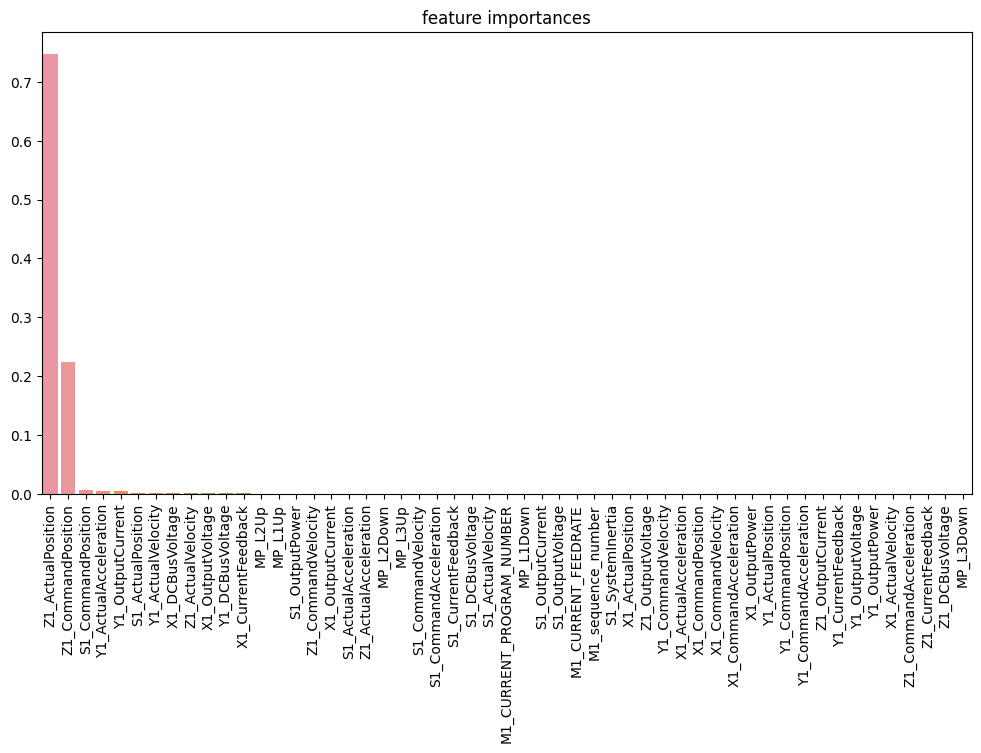

In [109]:
plt.figure(figsize=(12,6))
ax = sns.barplot(x=df_fi.index, y=df_fi.values)
ax.tick_params(axis = "x", rotation = 90)
plt.title('feature importances')
plt.savefig(r'image\feature_importances_dt.png', bbox_inches='tight')
plt.show()

加入頻譜分析為特徵，以GroupKFold驗證

比較加入經過特徵工程與頻譜分析的特徵是否能夠提升模型性能

features | mean accuracy
---|---
原有特徵 | 97.01%
加入頻率與振幅 | 98.09%

加入頻率域特徵後使準確率提升1.08%，表示雖然取樣頻率低，進行頻譜分析仍有助提升模型性能

觀察此決策樹的特徵重要度
除了'Z1_ActualPosition'與'Z1_CommandPosition'，新加入的頻率域特徵如'S1_DiffVelocity_amp'占的比重較其他特徵大

STFT

In [110]:
print(df_stft_mp.columns)

Index(['experiment', 'X1_ActualPosition', 'X1_ActualVelocity',
       'X1_ActualAcceleration', 'X1_CommandPosition', 'X1_CommandVelocity',
       'X1_CommandAcceleration', 'X1_CurrentFeedback', 'X1_DCBusVoltage',
       'X1_OutputCurrent', 'X1_OutputVoltage', 'X1_OutputPower',
       'Y1_ActualPosition', 'Y1_ActualVelocity', 'Y1_ActualAcceleration',
       'Y1_CommandPosition', 'Y1_CommandVelocity', 'Y1_CommandAcceleration',
       'Y1_CurrentFeedback', 'Y1_DCBusVoltage', 'Y1_OutputCurrent',
       'Y1_OutputVoltage', 'Y1_OutputPower', 'Z1_ActualPosition',
       'Z1_ActualVelocity', 'Z1_ActualAcceleration', 'Z1_CommandPosition',
       'Z1_CommandVelocity', 'Z1_CommandAcceleration', 'Z1_CurrentFeedback',
       'Z1_DCBusVoltage', 'Z1_OutputCurrent', 'Z1_OutputVoltage',
       'S1_ActualPosition', 'S1_ActualVelocity', 'S1_ActualAcceleration',
       'S1_CommandPosition', 'S1_CommandVelocity', 'S1_CommandAcceleration',
       'S1_CurrentFeedback', 'S1_DCBusVoltage', 'S1_OutputCurrent',


In [111]:
df_train = df_stft_mp.drop(['experiment', 'passed_visual_inspection', 'clamp_pressure', 'feedrate', 'machining_finalized'], axis=1)
Y = df_train['tool_condition']
X = df_train.drop('tool_condition', axis=1)

In [112]:
from sklearn.model_selection import GroupKFold
groups = df_stft_mp['experiment']
group_kfold = GroupKFold(n_splits=18)
accuracy_scores = []
cols = list(X.columns)
for train_index, test_index in group_kfold.split(X, Y, groups):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    Y_train, Y_test = Y.iloc[train_index], Y.iloc[test_index]
    clf = tree.DecisionTreeClassifier(max_depth=10, random_state=1234)
    clf.fit(X_train, Y_train)
    pred = clf.predict(X_test)
    exp = df_stft_mp.iloc[test_index]['experiment'].unique()
    acc = accuracy_score(Y_test, pred)
    print('no.', exp, ', test accuracy:', acc)
    df_fi = pd.Series(data = clf.feature_importances_, index = cols)
    df_fi = df_fi.sort_values(ascending=False)
    print('feature importances top 3:\n',df_fi.head(3))
    accuracy_scores.append(acc)
print(accuracy_scores)
print('mean scores:', np.mean(accuracy_scores))

no. [14] , test accuracy: 0.9930423782416192
feature importances top 3:
 Z1_ActualPosition          0.745466
Z1_CommandPosition         0.196485
Y1_DiffAcceleration_amp    0.020035
dtype: float64
no. [18] , test accuracy: 0.9715061058344641
feature importances top 3:
 Z1_CommandPosition     0.486865
Z1_ActualPosition      0.453119
S1_DiffVelocity_amp    0.017397
dtype: float64
no. [11] , test accuracy: 0.9616775126536515
feature importances top 3:
 Z1_ActualPosition          0.719434
Z1_CommandPosition         0.227291
X1_DiffAcceleration_amp    0.015326
dtype: float64
no. [12] , test accuracy: 0.95
feature importances top 3:
 Z1_ActualPosition     0.714187
Z1_CommandPosition    0.233003
S1_ActualPosition     0.012852
dtype: float64
no. [13] , test accuracy: 0.9477221807318895
feature importances top 3:
 Z1_ActualPosition          0.738055
Z1_CommandPosition         0.203583
Y1_DiffAcceleration_amp    0.016018
dtype: float64
no. [17] , test accuracy: 0.9716430358632193
feature importan

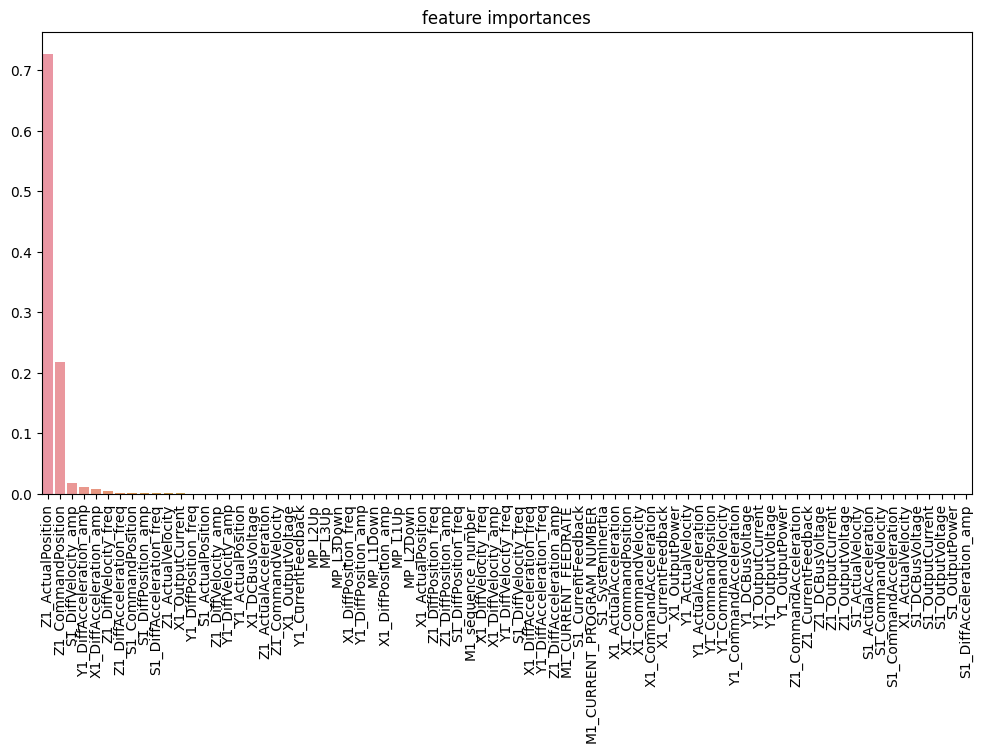

In [113]:
plt.figure(figsize=(12,6))
ax = sns.barplot(x=df_fi.index, y=df_fi.values)
ax.tick_params(axis = "x", rotation = 90)
plt.title('feature importances')
plt.savefig(r'image\feature_importances_dt_stft.png', bbox_inches='tight')
plt.show()

# 4.2. XGBoost

In [114]:
import xgboost as xgb

In [124]:
groups = df_stft_mp['experiment']
group_kfold = GroupKFold(n_splits=18)
accuracy_scores = []
cols = list(X.columns)

param = {
    'max_depth': 10,
    'eta': 0.3,
    'objective': 'binary:hinge'} 
epochs = 10
for train_index, test_index in group_kfold.split(X, Y, groups):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    Y_train, Y_test = Y.iloc[train_index], Y.iloc[test_index]
    train = xgb.DMatrix(X_train, label=Y_train)
    test = xgb.DMatrix(X_test, label=Y_test)
    
    clf = xgb.train(param, train, epochs)
    
    predictions = clf.predict(test)
    acc = accuracy_score(Y_test, predictions)
    
    exp = df_stft_mp.iloc[test_index]['experiment'].unique()
    print('no.', exp, ', test accuracy:', acc)
    feature_importances = clf.get_score(importance_type='gain')
    df_fi = pd.Series(data = feature_importances, index = cols)
    df_fi = df_fi.sort_values(ascending=False)
    print('feature importances top 3:\n',df_fi.head(3))
    accuracy_scores.append(acc)
print(accuracy_scores)
print('mean scores:', np.mean(accuracy_scores))

no. [14] , test accuracy: 0.9886148007590133
feature importances top 3:
 Z1_CommandPosition         1768.159302
Z1_ActualPosition          1033.096069
Y1_DiffAcceleration_amp     139.119507
dtype: float64
no. [18] , test accuracy: 0.9647218453188603
feature importances top 3:
 Z1_CommandPosition    1323.011597
Z1_ActualPosition     1043.980469
X1_OutputCurrent       432.380280
dtype: float64
no. [11] , test accuracy: 0.9667389732465654
feature importances top 3:
 Z1_CommandPosition         1014.441040
Z1_ActualPosition           933.287720
X1_DiffAcceleration_amp      85.205437
dtype: float64
no. [12] , test accuracy: 0.9449275362318841
feature importances top 3:
 Z1_CommandPosition         1427.744507
Z1_ActualPosition          1131.220947
Y1_DiffAcceleration_amp      54.261631
dtype: float64
no. [13] , test accuracy: 0.9499626587005228
feature importances top 3:
 Z1_ActualPosition          1125.261963
Z1_CommandPosition         1031.066528
Y1_DiffAcceleration_amp     121.545547
dtype

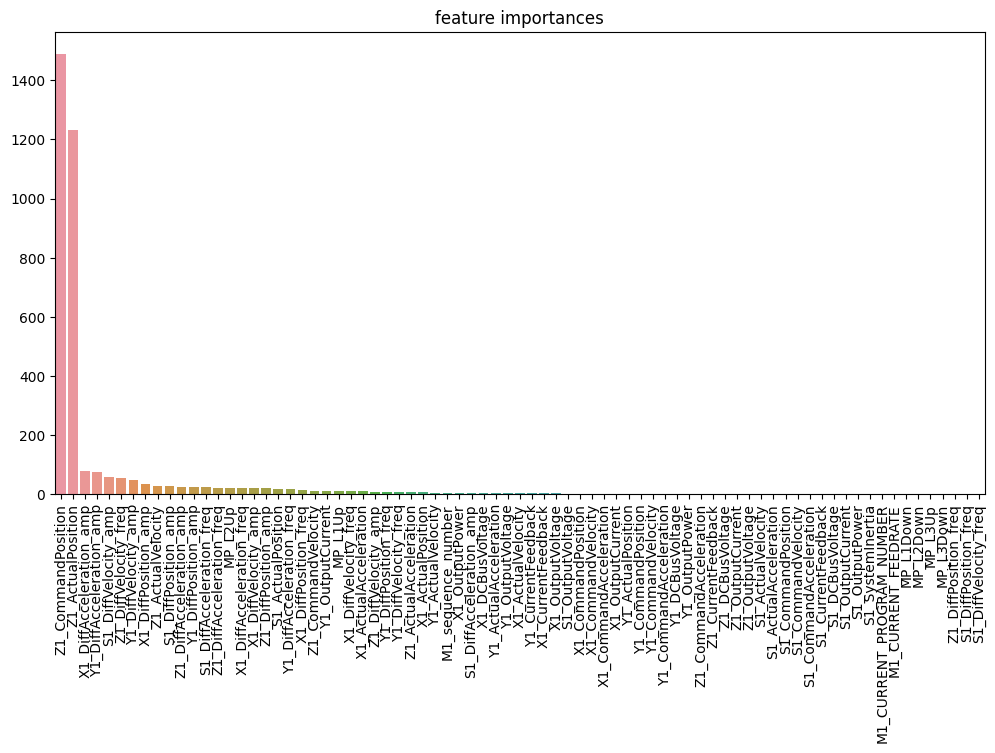

In [120]:
plt.figure(figsize=(12,6))
ax = sns.barplot(x=df_fi.index, y=df_fi.values)
ax.tick_params(axis = "x", rotation = 90)
plt.title('feature importances')
plt.savefig(r'image\feature_importances_xgb_stft.png', bbox_inches='tight')
plt.show()